In [2]:
import sys
import os

# Get the parent directory of the current folder
project_dir = os.path.abspath(os.path.join(os.getcwd(), '..'))
if project_dir not in sys.path:
    sys.path.insert(0, project_dir)


In [3]:
import numpy as np
import plotly.graph_objects as go
from scipy.optimize import minimize
from tqdm import tqdm
from scipy.stats import t, multivariate_normal, multivariate_t
from scipy.special import logsumexp, gamma, gammaln
from numpy.linalg import inv, det, slogdet, LinAlgError
import plotly.express as px
from plotly.subplots import make_subplots
from numpy import tril_indices, triu_indices
from typing import Literal, Optional, Dict, Union


from Functions.simulation_1 import * 
from Functions.gas_filter_5 import *
from Functions.kf_filter_5 import *

# True Model: $\Phi, P, Q$ All Diagonal

In [ ]:
# Explicit parameters with regressors
T = 1000
N = 3
K = 3

c_true_3x3 = np.array([0.2, -0.1, 0.4])

Phi_true_3x3_no_correl = np.array([[0.8, 0.0, 0.0],
                                [0.0, 0.9, 0.0],
                                [0.0, 0.0, 0.7]])

beta_true_3x3 = np.array([[1.0, -0.5, 0.2],
                          [-1.2, 0.8, 0.4],
                          [0.5, 1.5, -0.3]])

Q_true_3x3_no_correl = np.array([[0.7, 0.0, 0.0],
                                 [0.0, 0.5, 0.0],
                                 [0.0, 0.0, 0.6]])

R_true_3x3_no_correl = np.array([[0.4, 0.0, 0.0],
                                 [0.0, 0.8, 0.0],
                                 [0.0, 0.0, 0.5]])

# Run explicit simulation with regressors
y_sim_3x3_no_correl, mu_sim_3x3_no_correl, X_sim_3x3_no_correl = simulate_multivariate_state_space(
    T=T,
    N=N,
    c=c_true_3x3,
    Phi=Phi_true_3x3_no_correl,
    beta=beta_true_3x3,  
    Q=Q_true_3x3_no_correl,
    R=R_true_3x3_no_correl,
    use_intercept=None,
    seed=8888
)

# DCS-t Filter

In [5]:
gas_results_3x3_no_correl_1 = estimate_and_filter_gas(
    y=y_sim_3x3_no_correl,
    X=X_sim_3x3_no_correl, 
    phi_type="diagonal",
    kappa_type="full", 
    fix_nu=None)


mu_gas_3x3_no_correl_1 = gas_results_3x3_no_correl_1["mu_filtered"]
u_gas_3x3_no_correl_1 = gas_results_3x3_no_correl_1["u"]
resid_gas_no_correl_1 = gas_results_3x3_no_correl_1["resid"]
Kappa_est_3x3_no_correl_1 = gas_results_3x3_no_correl_1["Kappa"]

Estimated omega:
 [ 1.18769359 -0.92277462  1.30055838]
Estimated Phi:
 [[0.78463192 0.         0.        ]
 [0.         0.89030414 0.        ]
 [0.         0.         0.69665259]]
Estimated beta:
 [[ 1.04421166 -0.54193239  0.21172696]
 [-1.2253587   0.73078327  0.42802181]
 [ 0.52509892  1.4875123  -0.27759614]]
Estimated Omega (from lambda):
 [[1.1402079  0.         0.        ]
 [0.         1.64366524 0.        ]
 [0.         0.         1.19539551]]
Estimated Kappa:
 [[ 0.64163612  0.0352898   0.00244671]
 [ 0.10652148  0.83285835 -0.03214878]
 [-0.01641126 -0.05602893  0.46266955]]
Estimated nu:
 145.1459872093008
Log-likelihood: -4680.292186296037
AIC: 9416.584372592073
BIC: 9584.76266448628


In [6]:
kf_results_3x3_no_correl  =  multivariate_KF_with_estimation(
    y=y_sim_3x3_no_correl,
    X=X_sim_3x3_no_correl,
    initial_params=None,
    verbose=True,
    max_iter=1000
)

mu_kf_3x3_no_correl = kf_results_3x3_no_correl['mu_filtered']
P_kf_3x3_no_correl = kf_results_3x3_no_correl['P_filtered']
kalman_gain_kf_3x3_no_correl = kf_results_3x3_no_correl['kalman_gain']

✅ Kalman estimation completed successfully.
Estimated parameters:
omega (unconditional mean): [ 1.17149711 -0.92995868  1.31974863]
Phi (persistence matrix): 
[[ 0.73378616  0.02424565 -0.01707693]
 [ 0.03758229  0.92714488 -0.03040058]
 [-0.0220877  -0.01141044  0.65343522]]
beta: 
[[ 1.04491448 -0.53807502  0.2115541 ]
 [-1.22167809  0.73310668  0.42773515]
 [ 0.52104768  1.48067522 -0.27324111]]
Q (state noise covariance): 
[[0.65752033 0.00081088 0.02312753]
 [0.00081088 0.45382502 0.00070219]
 [0.02312753 0.00070219 0.49784893]]
R (observation noise covariance): 
[[3.52211496e-01 5.93473248e-04 5.93473248e-04]
 [5.93473248e-04 8.70738034e-01 6.11867149e-03]
 [5.93473248e-04 6.11867149e-03 5.65203588e-01]]
Log-likelihood: -4698.650958122255
AIC: 9463.30191624451
BIC: 9661.51204597697


In [7]:
T_3x3, R_3x3 = mu_sim_3x3_no_correl.shape
time_axis = list(range(T))

# Create subplot layout
fig_3x3_no_correl = make_subplots(rows=R_3x3, cols=1, shared_xaxes=True,
                    subplot_titles=[f"Dimension {i+1}" for i in range(R_3x3)])

for i in range(R_3x3):
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=y_sim_3x3_no_correl[:, i],
                             mode='lines', name=f'y[{i+1}] (Observed)',
                             line=dict(color='gray', width=1.5, dash='dot')),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_sim_3x3_no_correl[:, i],
                             mode='lines', name=f'mu_true[{i+1}]',
                             line=dict(color='blue', width=2)),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_gas_3x3_no_correl_1[:, i],
                             mode='lines', name=f'mu_gas[{i+1}]',
                             line=dict(color='red', width=2, dash='dash')),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_kf_3x3_no_correl[:, i],
                             mode='lines', name=f'mu_kf_3x3[{i+1}]',
                             line=dict(color='green', width=2, dash='dash')),
                  row=i+1, col=1)

fig_3x3_no_correl.update_layout(height=300*R_3x3, width=950,
                  title_text="GAS Filter: True vs Filtered Latent States",
                  template="plotly_white",
                  showlegend=True)

fig_3x3_no_correl.update_xaxes(title_text="Time", row=R_3x3, col=1)
fig_3x3_no_correl.update_yaxes(title_text="Value")

fig_3x3_no_correl.show()


## Parameter Estimation and DCS-t Filter with Fixed $\nu$ DoF

In [8]:
K = X_sim_3x3_no_correl.shape[1]
fix_nu = True         # Set False to estimate nu
nu_fixed_list = [5.0, 10.0, 30.0, 50.0, 100.0, 500.0, 1000]        # Set your desired fixed nu value here

gas_result_3x3_no_correl_phi_diag_kappa_diag = {}
gas_result_3x3_no_correl_phi_diag_kappa_full = {}

for nu_fixed in tqdm(nu_fixed_list, desc="Running GAS Estimation"):
    print(f"\nRunning GAS estimation with fixed nu = {nu_fixed}...")
    res_gas_phi_diag_kappa_diag = estimate_and_filter_gas(
        y = y_sim_3x3_no_correl,
        X =  X_sim_3x3_no_correl, 
        phi_type="diagonal", 
        kappa_type="diagonal", 
        fix_nu=nu_fixed,
        verbose=True
    )
    res_gas_phi_diag_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_no_correl,
        X =  X_sim_3x3_no_correl, 
        phi_type="diagonal", 
        kappa_type="full", 
        fix_nu=nu_fixed,
        verbose=True
    )
    
    gas_result_3x3_no_correl_phi_diag_kappa_diag[nu_fixed] = res_gas_phi_diag_kappa_diag
    gas_result_3x3_no_correl_phi_diag_kappa_full[nu_fixed] = res_gas_phi_diag_kappa_full
# check for nu free
res_gas_free_phi_diag_kappa_diag = estimate_and_filter_gas(
    y = y_sim_3x3_no_correl, 
    X = X_sim_3x3_no_correl, 
    phi_type="diagonal", 
    kappa_type="diagonal",   
    fix_nu=None, 
    verbose=True
)
# check for nu free
res_gas_free_phi_diag_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_no_correl, 
    X = X_sim_3x3_no_correl, 
    phi_type="diagonal", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)
# Store results for nu free estimation
gas_result_3x3_no_correl_phi_diag_kappa_diag['free'] = res_gas_free_phi_diag_kappa_diag
gas_result_3x3_no_correl_phi_diag_kappa_full['free'] = res_gas_free_phi_diag_kappa_full

Running GAS Estimation:   0%|          | 0/7 [00:00<?, ?it/s]


Running GAS estimation with fixed nu = 5.0...
Estimated omega:
 [ 1.2128026  -0.8739581   1.28996573]
Estimated Phi:
 [[0.79339837 0.         0.        ]
 [0.         0.89000968 0.        ]
 [0.         0.         0.68819215]]
Estimated beta:
 [[ 1.05279467 -0.55433299  0.19218854]
 [-1.20836318  0.7571628   0.4323739 ]
 [ 0.5288535   1.48489651 -0.27623197]]
Estimated Omega (from lambda):
 [[0.98583494 0.         0.        ]
 [0.         1.37528231 0.        ]
 [0.         0.         1.02058144]]
Estimated Kappa:
 [[0.94874095 0.         0.        ]
 [0.         1.3081844  0.        ]
 [0.         0.         0.66864706]]
Estimated nu:
 5.0
Log-likelihood: -4786.413967953081
AIC: 9614.827935906162
BIC: 9740.961654826817


Running GAS Estimation:  14%|█▍        | 1/7 [01:02<06:13, 62.33s/it]

Estimated omega:
 [ 1.21053839 -0.88413442  1.29096742]
Estimated Phi:
 [[0.79191316 0.         0.        ]
 [0.         0.89172796 0.        ]
 [0.         0.         0.68269009]]
Estimated beta:
 [[ 1.05100698 -0.55538764  0.19390814]
 [-1.20994984  0.75395641  0.42967891]
 [ 0.530874    1.48784808 -0.28141088]]
Estimated Omega (from lambda):
 [[0.98616544 0.         0.        ]
 [0.         1.37145971 0.        ]
 [0.         0.         1.01742347]]
Estimated Kappa:
 [[ 0.94523421  0.01117581 -0.00811202]
 [ 0.10540122  1.28865832 -0.07177589]
 [-0.02085202 -0.11285617  0.66704294]]
Estimated nu:
 5.0
Log-likelihood: -4782.7577988141775
AIC: 9619.515597628355
BIC: 9781.687521954911

Running GAS estimation with fixed nu = 10.0...
Estimated omega:
 [ 1.2096821  -0.90822671  1.29107433]
Estimated Phi:
 [[0.79059091 0.         0.        ]
 [0.         0.89013707 0.        ]
 [0.         0.         0.69125142]]
Estimated beta:
 [[ 1.04974773 -0.54816929  0.19691912]
 [-1.21679741  0.7491

Running GAS Estimation:  29%|██▊       | 2/7 [02:11<05:30, 66.19s/it]

Estimated omega:
 [ 1.20759495 -0.90692704  1.29191031]
Estimated Phi:
 [[0.78704415 0.         0.        ]
 [0.         0.89207468 0.        ]
 [0.         0.         0.68853179]]
Estimated beta:
 [[ 1.04825567 -0.54901575  0.19893155]
 [-1.21786499  0.74637206  0.42809493]
 [ 0.52885832  1.48882845 -0.28389274]]
Estimated Omega (from lambda):
 [[1.03539443 0.         0.        ]
 [0.         1.46018973 0.        ]
 [0.         0.         1.07799321]]
Estimated Kappa:
 [[ 0.7933472   0.02768831 -0.00193399]
 [ 0.10486388  1.0616781  -0.05845462]
 [-0.0180329  -0.08378195  0.56604504]]
Estimated nu:
 10.0
Log-likelihood: -4719.01710364242
AIC: 9492.03420728484
BIC: 9654.206131611396

Running GAS estimation with fixed nu = 30.0...
Estimated omega:
 [ 1.19700401 -0.9301318   1.29532206]
Estimated Phi:
 [[0.7899504 0.        0.       ]
 [0.        0.88946   0.       ]
 [0.        0.        0.6960158]]
Estimated beta:
 [[ 1.04655304 -0.54362332  0.20492649]
 [-1.22190605  0.73910542  0.428

Running GAS Estimation:  43%|████▎     | 3/7 [03:14<04:20, 65.07s/it]

Estimated omega:
 [ 1.19481798 -0.92489845  1.29603391]
Estimated Phi:
 [[0.7849647  0.         0.        ]
 [0.         0.89112203 0.        ]
 [0.         0.         0.69398774]]
Estimated beta:
 [[ 1.04523646 -0.54463934  0.20698441]
 [-1.22377438  0.73638651  0.42779102]
 [ 0.52674975  1.48806636 -0.28096032]]
Estimated Omega (from lambda):
 [[1.09803651 0.         0.        ]
 [0.         1.5716948  0.        ]
 [0.         0.         1.15073886]]
Estimated Kappa:
 [[ 0.68615498  0.03629523  0.00191495]
 [ 0.10681964  0.90031435 -0.04190138]
 [-0.0165865  -0.06328304  0.49294066]]
Estimated nu:
 30.0
Log-likelihood: -4686.501543261104
AIC: 9427.003086522209
BIC: 9589.175010848765

Running GAS estimation with fixed nu = 50.0...
Estimated omega:
 [ 1.19256735 -0.93133387  1.29752019]
Estimated Phi:
 [[0.78986136 0.         0.        ]
 [0.         0.88928468 0.        ]
 [0.         0.         0.69738568]]
Estimated beta:
 [[ 1.04593506 -0.54236412  0.20726093]
 [-1.22253298  0.7364

Running GAS Estimation:  57%|█████▋    | 4/7 [04:20<03:15, 65.18s/it]

Estimated omega:
 [ 1.19078931 -0.92867515  1.29816744]
Estimated Phi:
 [[0.78477201 0.         0.        ]
 [0.         0.89084048 0.        ]
 [0.         0.         0.69529517]]
Estimated beta:
 [[ 1.04466342 -0.54349216  0.20926656]
 [-1.22476687  0.73372247  0.42789168]
 [ 0.52605175  1.48784047 -0.2794415 ]]
Estimated Omega (from lambda):
 [[1.11724123 0.         0.        ]
 [0.         1.60486895 0.        ]
 [0.         0.         1.17170906]]
Estimated Kappa:
 [[ 0.66389719  0.03635963  0.00220867]
 [ 0.10696466  0.8666844  -0.03735667]
 [-0.01641897 -0.05948007  0.47770404]]
Estimated nu:
 50.0
Log-likelihood: -4682.580884207182
AIC: 9419.161768414364
BIC: 9581.33369274092

Running GAS estimation with fixed nu = 100.0...
Estimated omega:
 [ 1.18949335 -0.93401955  1.29974299]
Estimated Phi:
 [[0.78972501 0.         0.        ]
 [0.         0.88918475 0.        ]
 [0.         0.         0.69856953]]
Estimated beta:
 [[ 1.045552   -0.54110617  0.20919775]
 [-1.22287602  0.7341

Running GAS Estimation:  71%|███████▏  | 5/7 [05:41<02:22, 71.10s/it]

Estimated omega:
 [ 1.18785193 -0.93152989  1.3003143 ]
Estimated Phi:
 [[0.78464617 0.         0.        ]
 [0.         0.89060771 0.        ]
 [0.         0.         0.69632027]]
Estimated beta:
 [[ 1.04430001 -0.54236127  0.21112888]
 [-1.22540901  0.73149999  0.42800864]
 [ 0.52540092  1.48758894 -0.27800141]]
Estimated Omega (from lambda):
 [[1.13429534 0.         0.        ]
 [0.         1.63366438 0.        ]
 [0.         0.         1.18985359]]
Estimated Kappa:
 [[ 0.64696255  0.03561196  0.00237426]
 [ 0.1067247   0.84071787 -0.03359344]
 [-0.01642959 -0.0567689   0.46616461]]
Estimated nu:
 100.0
Log-likelihood: -4680.664464387715
AIC: 9415.32892877543
BIC: 9577.500853101987

Running GAS estimation with fixed nu = 500.0...
Estimated omega:
 [ 1.18705857 -0.93483842  1.30226632]
Estimated Phi:
 [[0.78951314 0.         0.        ]
 [0.         0.8890777  0.        ]
 [0.         0.         0.69953697]]
Estimated beta:
 [[ 1.04534468 -0.53978079  0.21085237]
 [-1.2230401   0.732

Running GAS Estimation:  86%|████████▌ | 6/7 [06:47<01:09, 69.17s/it]

Estimated omega:
 [ 1.18556778 -0.93334044  1.30270437]
Estimated Phi:
 [[0.7844988  0.         0.        ]
 [0.         0.89039451 0.        ]
 [0.         0.         0.6970616 ]]
Estimated beta:
 [[ 1.04412119 -0.54114173  0.21270859]
 [-1.2258644   0.72955907  0.42816071]
 [ 0.52473505  1.48735095 -0.27661603]]
Estimated Omega (from lambda):
 [[1.15035725 0.         0.        ]
 [0.         1.65995443 0.        ]
 [0.         0.         1.20628081]]
Estimated Kappa:
 [[ 0.63331806  0.03439211  0.00242334]
 [ 0.10633451  0.81965072 -0.03035933]
 [-0.01662656 -0.05473896  0.45695776]]
Estimated nu:
 500.0
Log-likelihood: -4679.955143294594
AIC: 9413.910286589187
BIC: 9576.082210915743

Running GAS estimation with fixed nu = 1000...
Estimated omega:
 [ 1.18674075 -0.93508155  1.30256483]
Estimated Phi:
 [[0.78948657 0.         0.        ]
 [0.         0.88907859 0.        ]
 [0.         0.         0.69958882]]
Estimated beta:
 [[ 1.04533633 -0.53958374  0.21105992]
 [-1.22305927  0.731

Running GAS Estimation: 100%|██████████| 7/7 [07:53<00:00, 67.69s/it]

Estimated omega:
 [ 1.18490127 -0.9324741   1.30298057]
Estimated Phi:
 [[0.78446854 0.         0.        ]
 [0.         0.89036295 0.        ]
 [0.         0.         0.69714952]]
Estimated beta:
 [[ 1.04410809 -0.54097254  0.21291466]
 [-1.22592594  0.72932421  0.42818132]
 [ 0.52463414  1.48732743 -0.27643419]]
Estimated Omega (from lambda):
 [[1.15249899 0.         0.        ]
 [0.         1.66346845 0.        ]
 [0.         0.         1.20849674]]
Estimated Kappa:
 [[ 0.631571    0.03419131  0.00242224]
 [ 0.10622217  0.81695412 -0.02992949]
 [-0.0166721  -0.05450357  0.45582196]]
Estimated nu:
 1000
Log-likelihood: -4679.927696460052
AIC: 9413.855392920104
BIC: 9576.02731724666


Estimated omega:
 [ 1.18912883 -0.94721217  1.31028259]
Estimated Phi:
 [[0.7898572  0.         0.        ]
 [0.         0.89010469 0.        ]
 [0.         0.         0.70106336]]
Estimated beta:
 [[ 1.04546841 -0.54048411  0.20991407]
 [-1.22297892  0.73284464  0.42852968]
 [ 0.52231167  1.48505125 -0.27387479]]
Estimated Omega (from lambda):
 [[1.13770623 0.         0.        ]
 [0.         1.65893507 0.        ]
 [0.         0.         1.20057543]]
Estimated Kappa:
 [[0.63911896 0.         0.        ]
 [0.         0.84331393 0.        ]
 [0.         0.         0.46481395]]
Estimated nu:
 153.694204759639
Log-likelihood: -4685.203452063198
AIC: 9414.406904126396
BIC: 9546.546990614701
Estimated omega:
 [ 1.18769359 -0.92277462  1.30055838]
Estimated Phi:
 [[0.78463192 0.         0.        ]
 [0.         0.89030414 0.        ]
 [0.         0.         0.69665259]]
Estimated beta:
 [[ 1.04421166 -0.54193239  0.21172696]
 [-1.2253587   0.73078327  0.42802181]
 [ 0.52509892  1.4875123  -

### $\Phi, \Kappa$ Diagonal Restricted

In [9]:
T, N, _ = kalman_gain_kf_3x3_no_correl.shape
nu_keys = list(gas_result_3x3_no_correl_phi_diag_kappa_diag.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

fig = make_subplots(
    rows=N, cols=N, 
    subplot_titles=[
        f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
    ]
)

for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_no_correl[:, i, j]
        fig.add_trace(
            go.Scatter(
                y=gain_series,
                mode='lines',
                name=f'Kalman Gain [{i+1},{j+1}]',
                line=dict(color='black', width=1.5),
                showlegend=False  # Do NOT show Kalman Gain traces in legend
            ),
            row=i+1, col=j+1
        )
        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_no_correl_phi_diag_kappa_diag[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"
            else:
                label = f"ν = {nu}"
            kappa_val = gas_result_3x3_no_correl_phi_diag_kappa_diag[nu]['Kappa'][i, j]
            # Only show ν legend in the [1,1] subplot
            showlegend = (i == 0 and j == 0)
            fig.add_trace(
                go.Scatter(
                    y=[kappa_val] * T,
                    mode='lines',
                    name=label,
                    line=dict(dash='dash', color=colors[k]),
                    showlegend=showlegend
                ),
                row=i+1, col=j+1
            )

fig.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white",
    legend=dict(
        orientation='h',
        yanchor='bottom',
        y=-0.1,  # move the legend below the plot
        xanchor='center',
        x=0.5,
        title_text="ν"
    )
)

fig.show()

### Phi Diag Kappa Full

In [ ]:
T, N, _ = kalman_gain_kf_3x3_no_correl.shape
nu_keys = list(gas_result_3x3_no_correl_phi_diag_kappa_full.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

fig = make_subplots(
    rows=N, cols=N, 
    subplot_titles=[
        f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
    ]
)

for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_no_correl[:, i, j]
        fig.add_trace(
            go.Scatter(
                y=gain_series,
                mode='lines',
                name=f'Kalman Gain [{i+1},{j+1}]',
                line=dict(color='black', width=1.5),
                showlegend=False  # Do NOT show Kalman Gain traces in legend
            ),
            row=i+1, col=j+1
        )
        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_no_correl_phi_diag_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"
            else:
                label = f"ν = {nu}"
            kappa_val = gas_result_3x3_no_correl_phi_diag_kappa_full[nu]['Kappa'][i, j]
            # Only show ν legend in the [1,1] subplot
            showlegend = (i == 0 and j == 0)
            fig.add_trace(
                go.Scatter(
                    y=[kappa_val] * T,
                    mode='lines',
                    name=label,
                    line=dict(dash='dash', color=colors[k]),
                    showlegend=showlegend
                ),
                row=i+1, col=j+1
            )

fig.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white",
    legend=dict(
        orientation='h',
        yanchor='bottom',
        y=-0.1,  # move the legend below the plot
        xanchor='center',
        x=0.5,
        title_text="ν"
    )
)

fig.show()

# True Model: $\Phi$ Full, $P, Q$ All Diagonal

In [11]:
# Explicit parameters with regressors
T = 1000
N = 3
K = 3

c_true_3x3 = np.array([0.2, -0.1, 0.4])

Phi_true_3x3_phi_full_no_noise_correl =  np.array([[0.8, 0.2, 0.1],
                                                    [0.1, 0.5, 0.1],
                                                    [0.1, 0.2, 0.6]])

# np.array([[0.8, 0.2, 0.1],
#                                                     [0, 0.85, 0.2],
#                                                     [0, 0.2, 0.6]])

beta_true_3x3 = np.array([[1.0, -0.5, 0.2],
                          [-1.2, 0.8, 0.4],
                          [0.5, 1.5, -0.3]])

Q_true_3x3_no_correl = np.array([[0.7, 0.0, 0.0],
                                 [0.0, 0.5, 0.0],
                                 [0.0, 0.0, 0.6]])

R_true_3x3_no_correl = np.array([[0.4, 0.0, 0.0],
                                 [0.0, 0.8, 0.0],
                                 [0.0, 0.0, 0.5]])

# Run explicit simulation with regressors
y_sim_3x3_phi_full_no_noise_correl, mu_sim_3x3_phi_full_no_noise_correl, X_sim_3x3_phi_full_no_noise_correl = simulate_multivariate_state_space(
    T=T,
    N=N,
    c=c_true_3x3,
    Phi=Phi_true_3x3_phi_full_no_noise_correl,
    beta=beta_true_3x3,  # Explicitly include regressors
    Q=Q_true_3x3_no_correl,
    R=R_true_3x3_no_correl,
    # use_intercept=None,
    seed=8888
)

print("✅ Multivariate State-Space Simulation with regressors completed.")

✅ Multivariate State-Space Simulation with regressors completed.


In [ ]:
import numpy as np

# Dimensions
N = y_sim_3x3_phi_full_no_noise_correl.shape[1]
K = X_sim_3x3_phi_full_no_noise_correl.shape[1]

# Custom starting values
omega_init = np.array([0.1, 0.0, 0.2])                 # Shape (N,)
Phi_init = 0.5 * np.eye(N).flatten()                   # Shape (N*N,)
beta_init = 0.5 * np.ones((K, N)).flatten()                 # Shape (K*N,)

# Cholesky lower-triangle of Q and R (unconstrained)
L_Q_init = np.ones(N * (N + 1) // 2)                   # Length N*(N+1)/2
L_R_init = np.ones(N * (N + 1) // 2)

# Concatenate into full initial parameter vector
initial_params = np.concatenate([omega_init, Phi_init, beta_init, L_Q_init, L_R_init])


In [13]:
gas_results_3x3_phi_full_no_correl_1 = estimate_and_filter_gas(
    y=y_sim_3x3_phi_full_no_noise_correl, 
    X=X_sim_3x3_phi_full_no_noise_correl,
    phi_type= "diagonal",
    kappa_type= "full",
    fix_nu=None
    )


mu_gas_3x3_phi_full_no_correl_1 = gas_results_3x3_phi_full_no_correl_1["mu_filtered"]
u_gas_3x3_phi_full_no_correl_1 = gas_results_3x3_phi_full_no_correl_1["u"]
resid_gas_phi_full_no_correl_1 = gas_results_3x3_phi_full_no_correl_1["resid"]
Kappa_est_3x3_phi_full_no_correl_1 = gas_results_3x3_phi_full_no_correl_1["Kappa"]

Estimated omega:
 [-0.42646174  0.06349006 -0.38338873]
Estimated Phi:
 [[0.91525164 0.         0.        ]
 [0.         0.89623346 0.        ]
 [0.         0.         0.88063182]]
Estimated beta:
 [[ 4.03256431  0.09645437  2.55903344]
 [-1.21827361  0.82875364  0.36076762]
 [ 0.45577869  1.45685626 -0.27020209]]
Estimated Omega (from lambda):
 [[1.31946546 0.         0.        ]
 [0.         1.33253688 0.        ]
 [0.         0.         1.2700441 ]]
Estimated Kappa:
 [[0.6758715  0.19439931 0.14514462]
 [0.14294505 0.1964072  0.15447083]
 [0.18855708 0.23440465 0.36157365]]
Estimated nu:
 157.663816943666
Log-likelihood: -4676.31733100444
AIC: 9408.63466200888
BIC: 9576.812953903087


In [14]:
kf_results_3x3_phi_full_no_correl  =  multivariate_KF_with_estimation(
    y=y_sim_3x3_phi_full_no_noise_correl,
    X=X_sim_3x3_phi_full_no_noise_correl,
    initial_params=None,
    verbose=True
)

mu_kf_3x3_phi_full_no_correl = kf_results_3x3_phi_full_no_correl['mu_filtered']
P_kf_3x3_phi_full_no_correl = kf_results_3x3_phi_full_no_correl['P_filtered']
kalman_gain_kf_3x3_phi_full_no_correl = kf_results_3x3_phi_full_no_correl['kalman_gain']

✅ Kalman estimation completed successfully.
Estimated parameters:
omega (unconditional mean): [0.04044277 0.34666222 0.35318767]
Phi (persistence matrix): 
[[0.80077667 0.32206181 0.07485476]
 [0.09293264 0.62814355 0.08894006]
 [0.10953338 0.43269761 0.43842652]]
beta: 
[[ 1.68886767 -0.94378196  0.82953733]
 [-1.21295462  0.82524972  0.36497187]
 [ 0.45407322  1.4582601  -0.26615678]]
Q (state noise covariance): 
[[5.95414309e-01 7.71630293e-04 7.71630293e-04]
 [7.71630293e-04 2.88802558e-01 5.38401673e-04]
 [7.71630293e-04 5.38401673e-04 8.10325024e-01]]
R (observation noise covariance): 
[[4.81159130e-01 6.93655627e-04 4.44200277e-02]
 [6.93655627e-04 9.37273528e-01 1.03216543e-03]
 [4.44200277e-02 1.03216543e-03 3.21678238e-01]]
Log-likelihood: -4655.275962953393
AIC: 9376.551925906786
BIC: 9574.762055639245


In [ ]:
K = X_sim_3x3_phi_full_no_noise_correl.shape[1]
fix_nu = True         # Set False to estimate nu
nu_fixed_list = [5.0, 10.0, 30.0, 50.0, 100.0, 500.0, 1000]        

gas_result_3x3_phi_full_restrictdiag_kappa_diag = {}
gas_result_3x3_phi_full_restrictdiag_kappa_full = {}
gas_result_3x3_phi_full_kappa_full = {}

for nu_fixed in tqdm(nu_fixed_list, desc="Running GAS Estimation"):
    print(f"\nRunning GAS estimation with fixed nu = {nu_fixed}...")
    res_gas_phi_diag_kappa_diag = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_no_noise_correl,
        X =  X_sim_3x3_phi_full_no_noise_correl, 
        phi_type="diagonal", 
        kappa_type="diagonal", 
        fix_nu=nu_fixed,
        verbose=True
    )
    
    res_gas_phi_diag_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_no_noise_correl,
        X =  X_sim_3x3_phi_full_no_noise_correl, 
        phi_type="diagonal", 
        kappa_type="full", 
        fix_nu=nu_fixed,
        verbose=True
    )
    
    res_gas_phi_full_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_no_noise_correl,
        X =  X_sim_3x3_phi_full_no_noise_correl, 
        phi_type="full",
        kappa_type="full",
        fix_nu=nu_fixed,
        verbose=True
    )

    gas_result_3x3_phi_full_restrictdiag_kappa_diag[nu_fixed] = res_gas_phi_diag_kappa_diag
    gas_result_3x3_phi_full_restrictdiag_kappa_full[nu_fixed] = res_gas_phi_diag_kappa_full
    gas_result_3x3_phi_full_kappa_full[nu_fixed] = res_gas_phi_full_kappa_full
    

res_gas_free_phi_diag_kappa_diag = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_no_noise_correl, 
    X = X_sim_3x3_phi_full_no_noise_correl, 
    phi_type="diagonal", 
    kappa_type="diagonal",   
    fix_nu=None, 
    verbose=True
)
res_gas_free_phi_diag_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_no_noise_correl, 
    X = X_sim_3x3_phi_full_no_noise_correl, 
    phi_type="diagonal", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)

res_gas_free_phi_full_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_no_noise_correl, 
    X = X_sim_3x3_phi_full_no_noise_correl, 
    phi_type="full", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)

gas_result_3x3_phi_full_restrictdiag_kappa_diag['free'] = res_gas_free_phi_diag_kappa_diag
gas_result_3x3_phi_full_restrictdiag_kappa_full['free'] = res_gas_free_phi_diag_kappa_full
gas_result_3x3_phi_full_kappa_full['free'] = res_gas_free_phi_full_kappa_full


Running GAS Estimation:   0%|          | 0/7 [00:00<?, ?it/s]


Running GAS estimation with fixed nu = 5.0...
Estimated omega:
 [0.36638886 0.0651804  0.13643961]
Estimated Phi:
 [[0.92738351 0.         0.        ]
 [0.         0.90924667 0.        ]
 [0.         0.         0.87912776]]
Estimated beta:
 [[ 3.11631238  0.0855868   1.95105785]
 [-1.2339663   0.82016467  0.35896465]
 [ 0.45444948  1.47429865 -0.26026012]]
Estimated Omega (from lambda):
 [[1.16986673 0.         0.        ]
 [0.         1.13860452 0.        ]
 [0.         0.         1.17416773]]
Estimated Kappa:
 [[1.26110423 0.         0.        ]
 [0.         0.50329178 0.        ]
 [0.         0.         0.9152003 ]]
Estimated nu:
 5.0
Log-likelihood: -4846.650012351457
AIC: 9735.300024702914
BIC: 9861.43374362357
Estimated omega:
 [0.2705015  0.06096317 0.06951183]
Estimated Phi:
 [[0.91919221 0.         0.        ]
 [0.         0.90122227 0.        ]
 [0.         0.         0.89032597]]
Estimated beta:
 [[ 3.27023679  0.08322471  2.04897508]
 [-1.24125536  0.82295854  0.34757396]


Running GAS Estimation:  14%|█▍        | 1/7 [02:43<16:21, 163.64s/it]

Estimated omega:
 [0.48622504 0.06933282 0.2137633 ]
Estimated Phi:
 [[0.79478894 0.32725216 0.04867691]
 [0.05567308 0.7073966  0.05802137]
 [0.11476846 0.41926107 0.43470467]]
Estimated beta:
 [[ 3.08864183  0.08864418  1.93104387]
 [-1.23152935  0.81650626  0.34940685]
 [ 0.4498599   1.47446163 -0.24717875]]
Estimated Omega (from lambda):
 [[1.09720862 0.         0.        ]
 [0.         1.07235947 0.        ]
 [0.         0.         1.05708796]]
Estimated Kappa:
 [[1.08037193 0.20693679 0.17068618]
 [0.14343002 0.37399268 0.21344975]
 [0.15665723 0.32455553 0.75162339]]
Estimated nu:
 5.0
Log-likelihood: -4742.717165656049
AIC: 9551.434331312097
BIC: 9749.644461044556

Running GAS estimation with fixed nu = 10.0...
Estimated omega:
 [0.50869286 0.03304699 0.24925744]
Estimated Phi:
 [[0.92721819 0.         0.        ]
 [0.         0.90819679 0.        ]
 [0.         0.         0.86741686]]
Estimated beta:
 [[ 3.02118045  0.11497019  1.87163476]
 [-1.22596467  0.82290642  0.36321149

Running GAS Estimation:  29%|██▊       | 2/7 [05:38<14:10, 170.11s/it]

Estimated omega:
 [0.58874157 0.04609676 0.30069498]
Estimated Phi:
 [[0.7975386  0.30500422 0.05675627]
 [0.052673   0.70886841 0.06166866]
 [0.10754148 0.43307216 0.43430428]]
Estimated beta:
 [[ 3.02221639  0.1254467   1.87205021]
 [-1.2246222   0.82126429  0.35604447]
 [ 0.44945124  1.46778459 -0.25733526]]
Estimated Omega (from lambda):
 [[1.15531479 0.         0.        ]
 [0.         1.16093925 0.        ]
 [0.         0.         1.11738185]]
Estimated Kappa:
 [[0.8825986  0.17661722 0.13164598]
 [0.13518887 0.31411895 0.16848227]
 [0.13161083 0.25894628 0.60452294]]
Estimated nu:
 10.0
Log-likelihood: -4682.880393568246
AIC: 9431.760787136493
BIC: 9629.970916868951

Running GAS estimation with fixed nu = 30.0...
Estimated omega:
 [0.89819859 0.03000272 0.51964088]
Estimated Phi:
 [[0.9260354  0.         0.        ]
 [0.         0.90790725 0.        ]
 [0.         0.         0.85801943]]
Estimated beta:
 [[ 2.68665301  0.11368502  1.63030842]
 [-1.21827074  0.82654876  0.3679866

Running GAS Estimation:  43%|████▎     | 3/7 [08:18<11:02, 165.67s/it]

Estimated omega:
 [0.94591409 0.04891597 0.55583503]
Estimated Phi:
 [[0.79723538 0.28784843 0.065047  ]
 [0.05223825 0.70546533 0.06348858]
 [0.09887507 0.4425869  0.43809199]]
Estimated beta:
 [[ 2.68862501  0.1304634   1.63809977]
 [-1.21786016  0.82472719  0.36188692]
 [ 0.45034457  1.46160798 -0.26499495]]
Estimated Omega (from lambda):
 [[1.23677312 0.         0.        ]
 [0.         1.26284303 0.        ]
 [0.         0.         1.18728555]]
Estimated Kappa:
 [[0.74917303 0.16164912 0.10340121]
 [0.12975167 0.27444021 0.13843647]
 [0.11478505 0.21310124 0.49899086]]
Estimated nu:
 30.0
Log-likelihood: -4652.983537949485
AIC: 9371.96707589897
BIC: 9570.17720563143

Running GAS estimation with fixed nu = 50.0...
Estimated omega:
 [1.11161434 0.04136656 0.65766425]
Estimated Phi:
 [[0.92560061 0.         0.        ]
 [0.         0.9080928  0.        ]
 [0.         0.         0.85612917]]
Estimated beta:
 [[ 2.48452996  0.10059367  1.49956335]
 [-1.21636333  0.82758938  0.36918828]

Running GAS Estimation:  57%|█████▋    | 4/7 [12:21<09:47, 196.00s/it]

Estimated omega:
 [1.17365223 0.06318654 0.70308246]
Estimated Phi:
 [[0.79718936 0.27930507 0.06959651]
 [0.05251116 0.70576282 0.06256588]
 [0.09618836 0.44366613 0.44078935]]
Estimated beta:
 [[ 2.46858292  0.11904948  1.49717552]
 [-1.21631227  0.82534727  0.36307647]
 [ 0.45115919  1.46035932 -0.26634028]]
Estimated Omega (from lambda):
 [[1.26105681 0.         0.        ]
 [0.         1.29116172 0.        ]
 [0.         0.         1.20698126]]
Estimated Kappa:
 [[0.72230926 0.16008056 0.09739212]
 [0.12892078 0.26674422 0.13234193]
 [0.11175562 0.20403864 0.47629868]]
Estimated nu:
 50.0
Log-likelihood: -4649.196999228921
AIC: 9364.393998457843
BIC: 9562.604128190302

Running GAS estimation with fixed nu = 100.0...
Estimated omega:
 [1.27025516 0.0510393  0.75839199]
Estimated Phi:
 [[0.92520407 0.         0.        ]
 [0.         0.90838922 0.        ]
 [0.         0.         0.85473841]]
Estimated beta:
 [[ 2.33527842  0.08911584  1.40495997]
 [-1.21482563  0.82843854  0.370147

Running GAS Estimation:  71%|███████▏  | 5/7 [16:09<06:55, 207.62s/it]

Estimated omega:
 [1.33983908 0.09818338 0.81105298]
Estimated Phi:
 [[0.79698111 0.27389176 0.0725235 ]
 [0.05258578 0.70527467 0.06251525]
 [0.09402827 0.44401802 0.44306893]]
Estimated beta:
 [[ 2.3038223   0.08427409  1.39174455]
 [-1.21512687  0.82575105  0.36399512]
 [ 0.45194531  1.45933614 -0.26708507]]
Estimated Omega (from lambda):
 [[1.28201875 0.         0.        ]
 [0.         1.31496858 0.        ]
 [0.         0.         1.22383941]]
Estimated Kappa:
 [[0.70212837 0.15921724 0.09306935]
 [0.12842044 0.26106747 0.12756518]
 [0.1096323  0.19742182 0.45870633]]
Estimated nu:
 100.0
Log-likelihood: -4647.131309493584
AIC: 9360.262618987168
BIC: 9558.472748719627

Running GAS estimation with fixed nu = 500.0...
Estimated omega:
 [1.33680485 0.05783477 0.80142866]
Estimated Phi:
 [[0.92481937 0.         0.        ]
 [0.         0.90874066 0.        ]
 [0.         0.         0.85360276]]
Estimated beta:
 [[ 2.27593468  0.0809877   1.36667913]
 [-1.21348526  0.82914408  0.37094

Running GAS Estimation:  86%|████████▌ | 6/7 [20:12<03:39, 219.60s/it]

Estimated omega:
 [1.39409925 0.08164616 0.84470344]
Estimated Phi:
 [[0.79714588 0.26401328 0.0779464 ]
 [0.05260151 0.70661482 0.06142631]
 [0.09166115 0.44573047 0.44504737]]
Estimated beta:
 [[ 2.25448331  0.10285579  1.36257602]
 [-1.21410544  0.82602515  0.36470323]
 [ 0.45289813  1.45856111 -0.26752877]]
Estimated Omega (from lambda):
 [[1.3004776  0.         0.        ]
 [0.         1.33600072 0.        ]
 [0.         0.         1.23900085]]
Estimated Kappa:
 [[0.68569295 0.15916551 0.08912877]
 [0.1281107  0.25648077 0.12370159]
 [0.10807848 0.19215791 0.44444326]]
Estimated nu:
 500.0
Log-likelihood: -4646.073248716641
AIC: 9358.146497433281
BIC: 9556.35662716574

Running GAS estimation with fixed nu = 1000...
Estimated omega:
 [1.3632588  0.05918354 0.81812685]
Estimated Phi:
 [[0.92478566 0.         0.        ]
 [0.         0.90878616 0.        ]
 [0.         0.         0.85350703]]
Estimated beta:
 [[ 2.24994334  0.07928396  1.35109146]
 [-1.21330652  0.82924473  0.3710497

Running GAS Estimation: 100%|██████████| 7/7 [23:47<00:00, 203.98s/it]

Estimated omega:
 [1.43121275 0.08346227 0.8674088 ]
Estimated Phi:
 [[0.79711148 0.2637967  0.07804844]
 [0.05267345 0.7071042  0.06093645]
 [0.09132186 0.44622063 0.44519355]]
Estimated beta:
 [[ 2.21824332  0.10130528  1.34047297]
 [-1.21399181  0.82606159  0.36476993]
 [ 0.45299574  1.4584729  -0.26758837]]
Estimated Omega (from lambda):
 [[1.30317023 0.         0.        ]
 [0.         1.33879923 0.        ]
 [0.         0.         1.2410342 ]]
Estimated Kappa:
 [[0.68371176 0.15915309 0.08874992]
 [0.12807898 0.25584509 0.12332608]
 [0.10790119 0.1914723  0.44257849]]
Estimated nu:
 1000
Log-likelihood: -4645.983972226177
AIC: 9357.967944452354
BIC: 9556.178074184812


Estimated omega:
 [-6.51920611  0.0082451  -4.40926038]
Estimated Phi:
 [[0.92503755 0.         0.        ]
 [0.         0.90852438 0.        ]
 [0.         0.         0.85419866]]
Estimated beta:
 [[10.12598227  0.13167077  6.57451287]
 [-1.21419893  0.82875738  0.37053095]
 [ 0.46047701  1.4514915  -0.27534401]]
Estimated Omega (from lambda):
 [[1.35692982 0.         0.        ]
 [0.         1.39710481 0.        ]
 [0.         0.         1.35331187]]
Estimated Kappa:
 [[0.79923492 0.         0.        ]
 [0.         0.32803307 0.        ]
 [0.         0.         0.59303193]]
Estimated nu:
 161.9006720506885
Log-likelihood: -4745.681913451914
AIC: 9535.363826903827
BIC: 9667.503913392133
Estimated omega:
 [-0.42646174  0.06349006 -0.38338873]
Estimated Phi:
 [[0.91525164 0.         0.        ]
 [0.         0.89623346 0.        ]
 [0.         0.         0.88063182]]
Estimated beta:
 [[ 4.03256431  0.09645437  2.55903344]
 [-1.21827361  0.82875364  0.36076762]
 [ 0.45577869  1.45685626 

In [16]:
T_3x3, R_3x3 = mu_sim_3x3_phi_full_no_noise_correl.shape
time_axis = list(range(T))

# Create subplot layout
fig_3x3_no_correl = make_subplots(rows=R_3x3, cols=1, shared_xaxes=True,
                    subplot_titles=[f"Dimension {i+1}" for i in range(R_3x3)])

for i in range(R_3x3):
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=y_sim_3x3_phi_full_no_noise_correl[:, i],
                             mode='lines', name=f'y[{i+1}] (Observed)',
                             line=dict(color='gray', width=1.5, dash='dot')),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_sim_3x3_phi_full_no_noise_correl[:, i],
                             mode='lines', name=f'mu_true[{i+1}]',
                             line=dict(color='blue', width=2)),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_gas_3x3_phi_full_no_correl_1[:, i],
                             mode='lines', name=f'mu_gas[{i+1}]',
                             line=dict(color='red', width=2, dash='dash')),
                  row=i+1, col=1)
    fig_3x3_no_correl.add_trace(go.Scatter(x=time_axis, y=mu_kf_3x3_phi_full_no_correl[:, i],
                             mode='lines', name=f'mu_kf_3x3[{i+1}]',
                             line=dict(color='green', width=2, dash='dash')),
                  row=i+1, col=1)

fig_3x3_no_correl.update_layout(height=300*R_3x3, width=950,
                  title_text="GAS Filter: True vs Filtered Latent States",
                  template="plotly_white",
                  showlegend=True)

fig_3x3_no_correl.update_xaxes(title_text="Time", row=R_3x3, col=1)
fig_3x3_no_correl.update_yaxes(title_text="Value")

fig_3x3_no_correl.show()

### $\Phi, \kappa$ Diagonal

In [ ]:
T, N, _ = kalman_gain_kf_3x3_phi_full_no_correl.shape
nu_keys = list(gas_result_3x3_phi_full_restrictdiag_kappa_diag.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

fig_3x3_phi_full_restrictdiag_kappa_diag_no_correl = make_subplots(
    rows=N, cols=N, 
    subplot_titles=[
        f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
    ]
)

for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_no_correl[:, i, j]
        fig_3x3_phi_full_restrictdiag_kappa_diag_no_correl.add_trace(
            go.Scatter(
                y=gain_series,
                mode='lines',
                name=f'Kalman Gain [{i+1},{j+1}]',
                line=dict(color='black', width=1.5),
                showlegend=False  # Do NOT show Kalman Gain traces in legend
            ),
            row=i+1, col=j+1
        )
        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_phi_full_restrictdiag_kappa_diag[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"
            else:
                label = f"ν = {nu}"
            kappa_val = gas_result_3x3_phi_full_restrictdiag_kappa_diag[nu]['Kappa'][i, j]
            # Only show ν legend in the [1,1] subplot
            showlegend = (i == 0 and j == 0)
            fig_3x3_phi_full_restrictdiag_kappa_diag_no_correl.add_trace(
                go.Scatter(
                    y=[kappa_val] * T,
                    mode='lines',
                    name=label,
                    line=dict(dash='dash', color=colors[k]),
                    showlegend=showlegend
                ),
                row=i+1, col=j+1
            )

fig_3x3_phi_full_restrictdiag_kappa_diag_no_correl.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white",
    legend=dict(
        orientation='h',
        yanchor='bottom',
        y=-0.1,  # move the legend below the plot
        xanchor='center',
        x=0.5,
        title_text="ν"
    )
)

fig_3x3_phi_full_restrictdiag_kappa_diag_no_correl.show()

### $\Phi$ Full $\kappa$ Diagonal

In [19]:
# T, N, _ = kalman_gain_kf_3x3_phi_full_no_correl.shape
# nu_keys = list(gas_result_3x3_phi_full_restrictdiag_kappa_diag.keys())
# colors = px.colors.qualitative.Set1[:len(nu_keys)]
T, N, _ = kalman_gain_kf_3x3_phi_full_no_correl.shape
nu_keys = list(gas_result_3x3_phi_full_restrictdiag_kappa_full.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

fig_3x3_phi_full_restrictdiag_kappa_full_no_correl = make_subplots(
    rows=N, cols=N, 
    subplot_titles=[
        f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
    ]
)

for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_no_correl[:, i, j]
        fig_3x3_phi_full_restrictdiag_kappa_full_no_correl.add_trace(
            go.Scatter(
                y=gain_series,
                mode='lines',
                name=f'Kalman Gain [{i+1},{j+1}]',
                line=dict(color='black', width=1.5),
                showlegend=False  # Do NOT show Kalman Gain traces in legend
            ),
            row=i+1, col=j+1
        )
        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_phi_full_restrictdiag_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"
            else:
                label = f"ν = {nu}"
            kappa_val = gas_result_3x3_phi_full_restrictdiag_kappa_full[nu]['Kappa'][i, j]
            # Only show ν legend in the [1,1] subplot
            showlegend = (i == 0 and j == 0)
            fig_3x3_phi_full_restrictdiag_kappa_full_no_correl.add_trace(
                go.Scatter(
                    y=[kappa_val] * T,
                    mode='lines',
                    name=label,
                    line=dict(dash='dash', color=colors[k]),
                    showlegend=showlegend
                ),
                row=i+1, col=j+1
            )

fig_3x3_phi_full_restrictdiag_kappa_full_no_correl.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white",
    legend=dict(
        orientation='h',
        yanchor='bottom',
        y=-0.1,  # move the legend below the plot
        xanchor='center',
        x=0.5,
        title_text="ν"
    )
)

fig_3x3_phi_full_restrictdiag_kappa_full_no_correl.show()

### $\Phi$, $\kappa$ Full

In [21]:
T, N, _ = kalman_gain_kf_3x3_phi_full_no_correl.shape
nu_keys = list(gas_result_3x3_phi_full_restrictdiag_kappa_full.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]

fig_3x3_phi_full_kappa_full_no_correl = make_subplots(
    rows=N, cols=N, 
    subplot_titles=[
        f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
    ]
)

for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_no_correl[:, i, j]
        fig_3x3_phi_full_kappa_full_no_correl.add_trace(
            go.Scatter(
                y=gain_series,
                mode='lines',
                name=f'Kalman Gain [{i+1},{j+1}]',
                line=dict(color='black', width=1.5),
                showlegend=False  # Do NOT show Kalman Gain traces in legend
            ),
            row=i+1, col=j+1
        )
        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_phi_full_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"
            else:
                label = f"ν = {nu}"
            kappa_val = gas_result_3x3_phi_full_kappa_full[nu]['Kappa'][i, j]
            # Only show ν legend in the [1,1] subplot
            showlegend = (i == 0 and j == 0)
            fig_3x3_phi_full_kappa_full_no_correl.add_trace(
                go.Scatter(
                    y=[kappa_val] * T,
                    mode='lines',
                    name=label,
                    line=dict(dash='dash', color=colors[k]),
                    showlegend=showlegend
                ),
                row=i+1, col=j+1
            )

fig_3x3_phi_full_kappa_full_no_correl.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white",
    legend=dict(
        orientation='h',
        yanchor='bottom',
        y=-0.1,  # move the legend below the plot
        xanchor='center',
        x=0.5,
        title_text="ν"
    )
)

fig_3x3_phi_full_kappa_full_no_correl.show()

# True Model: $\Phi$ Diagonal, $Q,R$ Full

In [22]:
T = 1000
N = 3
K = 3

c_true_3x3 = np.array([0.2, -0.1, 0.4])

Phi_true_3x3_phi_diag_yes_noise_correl = np.array([[0.8, 0.0, 0.0],
                         [0.0, 0.9, 0.0],
                         [0.0, 0.0, 0.7]])

beta_true_3x3 = np.array([[1.0, -0.5, 0.2],
                          [-1.2, 0.8, 0.4],
                          [0.5, 1.5, -0.3]])

Q_true_3x3_yes_correl = np.array([[0.7, 0.2, 0.3],
                                 [0.2, 0.5, 0.1],
                                 [0.3, 0.1, 0.6]])

R_true_3x3_yes_correl = np.array([[0.4, 0.1, 0.2],
                                 [0.1, 0.8, 0.3],
                                 [0.2, 0.3, 0.5]])

# Run explicit simulation with regressors
y_sim_3x3_phi_diag_yes_noise_correl, mu_sim_3x3_phi_diag_yes_noise_correl, X_sim_3x3_phi_diag_yes_noise_correl = simulate_multivariate_state_space(
    T=T,
    N=N,
    c=c_true_3x3,
    Phi=Phi_true_3x3_phi_diag_yes_noise_correl,
    beta=beta_true_3x3,  # Explicitly include regressors
    Q=Q_true_3x3_yes_correl,
    R=R_true_3x3_yes_correl,
    # use_intercept=None,
    seed=8888
)

print("✅ Multivariate State-Space Simulation with regressors completed.")

✅ Multivariate State-Space Simulation with regressors completed.


In [23]:
kf_results_3x3_phi_diag_yes_correl  =  multivariate_KF_with_estimation(
    y=y_sim_3x3_phi_diag_yes_noise_correl,
    X=X_sim_3x3_phi_diag_yes_noise_correl,
    initial_params=None,
    verbose=True,
    max_iter=1000
)

mu_kf_3x3_phi_diag_yes_correl = kf_results_3x3_phi_diag_yes_correl['mu_filtered']
P_kf_3x3_phi_diag_yes_correl = kf_results_3x3_phi_diag_yes_correl['P_filtered']
kalman_gain_kf_3x3_phi_diag_yes_correl = kf_results_3x3_phi_diag_yes_correl['kalman_gain']

✅ Kalman estimation completed successfully.
Estimated parameters:
omega (unconditional mean): [0.17297523 0.26979408 0.35340758]
Phi (persistence matrix): 
[[ 7.91506699e-01  1.28347412e-02 -3.15066916e-03]
 [-6.09137350e-04  9.07509800e-01 -8.38321432e-03]
 [-6.04262144e-02  3.61010486e-02  7.63507409e-01]]
beta: 
[[ 1.81440318 -1.69113253  1.27254779]
 [-1.21056422  0.7722496   0.37014538]
 [ 0.55214055  1.56437821 -0.26783291]]
Q (state noise covariance): 
[[0.7832281  0.19169395 0.37863284]
 [0.19169395 0.412463   0.09327456]
 [0.37863284 0.09327456 0.58994811]]
R (observation noise covariance): 
[[0.380478   0.13176757 0.16927433]
 [0.13176757 0.75681553 0.28928148]
 [0.16927433 0.28928148 0.53979724]]
Log-likelihood: -4538.345590378497
AIC: 9142.691180756994
BIC: 9340.901310489453


In [24]:
K = X_sim_3x3_phi_diag_yes_noise_correl.shape[1]
fix_nu = True         # Set False to estimate nu
nu_fixed_list = [5.0, 10.0, 30.0, 50.0, 100.0, 500.0, 1000]        # Set your desired fixed nu value here

gas_result_3x3_yes_correl_phi_diag_kappa_diag = {}
gas_result_3x3_yes_correl_phi_diag_kappa_full = {}

for nu_fixed in tqdm(nu_fixed_list, desc="Running GAS Estimation"):
    print(f"\nRunning GAS estimation with fixed nu = {nu_fixed}...")
    res_gas_phi_diag_kappa_diag = estimate_and_filter_gas(
        y = y_sim_3x3_phi_diag_yes_noise_correl,
        X =  X_sim_3x3_phi_diag_yes_noise_correl, 
        phi_type="diagonal", 
        kappa_type="diagonal", 
        fix_nu=nu_fixed,
        verbose=True
    )
    res_gas_phi_diag_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_phi_diag_yes_noise_correl,
        X =  X_sim_3x3_phi_diag_yes_noise_correl, 
        phi_type="diagonal", 
        kappa_type="full", 
        fix_nu=nu_fixed,
        verbose=True
    )
    
    gas_result_3x3_yes_correl_phi_diag_kappa_diag[nu_fixed] = res_gas_phi_diag_kappa_diag
    gas_result_3x3_yes_correl_phi_diag_kappa_full[nu_fixed] = res_gas_phi_diag_kappa_full
    
# check for nu free
res_gas_free_phi_diag_kappa_diag = estimate_and_filter_gas(
    y = y_sim_3x3_phi_diag_yes_noise_correl, 
    X = X_sim_3x3_phi_diag_yes_noise_correl, 
    phi_type="diagonal", 
    kappa_type="diagonal",   
    fix_nu=None, 
    verbose=True
)
# check for nu free
res_gas_free_phi_diag_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_phi_diag_yes_noise_correl, 
    X = X_sim_3x3_phi_diag_yes_noise_correl, 
    phi_type="diagonal", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)
# Store results for nu free estimation
gas_result_3x3_yes_correl_phi_diag_kappa_diag['free'] = res_gas_free_phi_diag_kappa_diag
gas_result_3x3_yes_correl_phi_diag_kappa_full['free'] = res_gas_free_phi_diag_kappa_full

Running GAS Estimation:   0%|          | 0/7 [00:00<?, ?it/s]


Running GAS estimation with fixed nu = 5.0...
Estimated omega:
 [ 0.202367   -0.17692994  0.09094902]
Estimated Phi:
 [[0.80377418 0.         0.        ]
 [0.         0.90177404 0.        ]
 [0.         0.         0.7652117 ]]
Estimated beta:
 [[ 1.76401924 -1.29913137  1.53953661]
 [-1.198221    0.7760122   0.38290561]
 [ 0.5244262   1.5510423  -0.30130281]]
Estimated Omega (from lambda):
 [[1.0888715  0.         0.        ]
 [0.         1.17897225 0.        ]
 [0.         0.         1.04832158]]
Estimated Kappa:
 [[1.10843079 0.         0.        ]
 [0.         0.9938138  0.        ]
 [0.         0.         0.84142908]]
Estimated nu:
 5.0
Log-likelihood: -4801.533067952856
AIC: 9645.066135905712
BIC: 9771.199854826367


Running GAS Estimation:  14%|█▍        | 1/7 [00:47<04:44, 47.47s/it]

Estimated omega:
 [ 0.20276813 -0.17592396  0.09169229]
Estimated Phi:
 [[0.80320751 0.         0.        ]
 [0.         0.90614176 0.        ]
 [0.         0.         0.76322553]]
Estimated beta:
 [[ 1.75962515 -1.29467884  1.53583113]
 [-1.19779695  0.77844902  0.38588588]
 [ 0.52214092  1.54965894 -0.29988591]]
Estimated Omega (from lambda):
 [[1.08408561 0.         0.        ]
 [0.         1.17252332 0.        ]
 [0.         0.         1.04504753]]
Estimated Kappa:
 [[ 1.0479732   0.0724402   0.1088963 ]
 [ 0.12772867  0.97968843 -0.1018674 ]
 [-0.00108758 -0.09528063  0.86703875]]
Estimated nu:
 5.0
Log-likelihood: -4795.635274396096
AIC: 9645.270548792192
BIC: 9807.442473118748

Running GAS estimation with fixed nu = 10.0...
Estimated omega:
 [ 0.34280338 -0.27929074  0.24565213]
Estimated Phi:
 [[0.799422   0.         0.        ]
 [0.         0.90586419 0.        ]
 [0.         0.         0.75484199]]
Estimated beta:
 [[ 1.62338018 -1.18323384  1.38008061]
 [-1.20525309  0.77242

Running GAS Estimation:  29%|██▊       | 2/7 [01:33<03:54, 46.80s/it]

Estimated omega:
 [ 0.34314518 -0.27891048  0.24640726]
Estimated Phi:
 [[0.79951629 0.         0.        ]
 [0.         0.90985126 0.        ]
 [0.         0.         0.75431576]]
Estimated beta:
 [[ 1.62078573 -1.18077803  1.37823559]
 [-1.20571577  0.77230284  0.38100103]
 [ 0.53263234  1.55530602 -0.28757911]]
Estimated Omega (from lambda):
 [[1.1602017  0.         0.        ]
 [0.         1.2656167  0.        ]
 [0.         0.         1.12670346]]
Estimated Kappa:
 [[ 0.89432214  0.04802402  0.08333044]
 [ 0.09674204  0.81049243 -0.09908228]
 [-0.00443039 -0.09358365  0.74166721]]
Estimated nu:
 10.0
Log-likelihood: -4742.63394251532
AIC: 9539.26788503064
BIC: 9701.439809357196

Running GAS estimation with fixed nu = 30.0...
Estimated omega:
 [ 0.57452849 -0.42974323  0.46513945]
Estimated Phi:
 [[0.79716795 0.         0.        ]
 [0.         0.90807938 0.        ]
 [0.         0.         0.74991362]]
Estimated beta:
 [[ 1.39985503 -1.01328669  1.15977259]
 [-1.208984    0.772761

Running GAS Estimation:  43%|████▎     | 3/7 [02:24<03:14, 48.63s/it]

Estimated omega:
 [ 0.57219243 -0.42839788  0.46384171]
Estimated Phi:
 [[0.79785726 0.         0.        ]
 [0.         0.91212938 0.        ]
 [0.         0.         0.7495448 ]]
Estimated beta:
 [[ 1.40057722 -1.01410303  1.16104793]
 [-1.21027527  0.77101285  0.37572198]
 [ 0.54290473  1.56030207 -0.27521736]]
Estimated Omega (from lambda):
 [[1.24959993 0.         0.        ]
 [0.         1.37303312 0.        ]
 [0.         0.         1.22042529]]
Estimated Kappa:
 [[ 0.78575146  0.03307341  0.05601354]
 [ 0.07809241  0.69796627 -0.09940566]
 [-0.00489212 -0.08616074  0.64382451]]
Estimated nu:
 30.0
Log-likelihood: -4720.217146985626
AIC: 9494.434293971251
BIC: 9656.606218297808

Running GAS estimation with fixed nu = 50.0...
Estimated omega:
 [ 0.64524159 -0.47448229  0.52693188]
Estimated Phi:
 [[0.79726662 0.         0.        ]
 [0.         0.90830257 0.        ]
 [0.         0.         0.74923262]]
Estimated beta:
 [[ 1.33323878 -0.96256252  1.09845442]
 [-1.2093707   0.7731

Running GAS Estimation:  57%|█████▋    | 4/7 [03:19<02:32, 50.96s/it]

Estimated omega:
 [ 0.64282235 -0.47308576  0.52568873]
Estimated Phi:
 [[0.79793964 0.         0.        ]
 [0.         0.91241441 0.        ]
 [0.         0.         0.74882098]]
Estimated beta:
 [[ 1.33435543 -0.96367405  1.10014972]
 [-1.21082302  0.77110049  0.37423959]
 [ 0.54550452  1.56152301 -0.27216093]]
Estimated Omega (from lambda):
 [[1.27702929 0.         0.        ]
 [0.         1.40353271 0.        ]
 [0.         0.         1.24830432]]
Estimated Kappa:
 [[ 0.76290517  0.03101012  0.04774733]
 [ 0.07511201  0.67640964 -0.10061028]
 [-0.0058346  -0.08371705  0.62179296]]
Estimated nu:
 50.0
Log-likelihood: -4719.215866317907
AIC: 9492.431732635814
BIC: 9654.60365696237

Running GAS estimation with fixed nu = 100.0...
Estimated omega:
 [ 0.69891011 -0.50767663  0.57285981]
Estimated Phi:
 [[0.79756297 0.         0.        ]
 [0.         0.90837188 0.        ]
 [0.         0.         0.74872991]]
Estimated beta:
 [[ 1.28380781 -0.92374479  1.05315355]
 [-1.20951516  0.7734

Running GAS Estimation:  71%|███████▏  | 5/7 [04:17<01:47, 53.74s/it]

Estimated omega:
 [ 0.69790822 -0.50734007  0.57282481]
Estimated Phi:
 [[0.79818273 0.         0.        ]
 [0.         0.91256573 0.        ]
 [0.         0.         0.74825393]]
Estimated beta:
 [[ 1.28371693 -0.92405424  1.05386591]
 [-1.21109044  0.7712327   0.37294039]
 [ 0.54772823  1.56263271 -0.2696223 ]]
Estimated Omega (from lambda):
 [[1.30200235 0.         0.        ]
 [0.         1.42977865 0.        ]
 [0.         0.         1.27359862]]
Estimated Kappa:
 [[ 0.74569906  0.0298872   0.04013409]
 [ 0.07324524  0.66082198 -0.10227344]
 [-0.00706372 -0.08142105  0.60447984]]
Estimated nu:
 100.0
Log-likelihood: -4719.94543582539
AIC: 9493.89087165078
BIC: 9656.062795977336

Running GAS estimation with fixed nu = 500.0...
Estimated omega:
 [ 0.75800239 -0.54504189  0.62240363]
Estimated Phi:
 [[0.79796661 0.         0.        ]
 [0.         0.90833326 0.        ]
 [0.         0.         0.74823725]]
Estimated beta:
 [[ 1.22926684 -0.88175599  1.00393016]
 [-1.20948536  0.7736

Running GAS Estimation:  86%|████████▌ | 6/7 [05:11<00:53, 53.86s/it]

Estimated omega:
 [ 0.76008692 -0.54670666  0.62511474]
Estimated Phi:
 [[0.7984552  0.         0.        ]
 [0.         0.91260086 0.        ]
 [0.         0.         0.74776787]]
Estimated beta:
 [[ 1.22589194 -0.87952049  1.0022221 ]
 [-1.21114596  0.77133071  0.37168575]
 [ 0.54972342  1.56377311 -0.26730177]]
Estimated Omega (from lambda):
 [[1.32603643 0.         0.        ]
 [0.         1.45337298 0.        ]
 [0.         0.         1.2977973 ]]
Estimated Kappa:
 [[ 0.73203416  0.02932699  0.03282277]
 [ 0.07207378  0.64893353 -0.10437047]
 [-0.00842469 -0.07926475  0.58994237]]
Estimated nu:
 500.0
Log-likelihood: -4721.776446686183
AIC: 9497.552893372365
BIC: 9659.724817698921

Running GAS estimation with fixed nu = 1000...
Estimated omega:
 [ 0.7616166  -0.54690382  0.62574791]
Estimated Phi:
 [[0.79803136 0.         0.        ]
 [0.         0.90831102 0.        ]
 [0.         0.         0.74816639]]
Estimated beta:
 [[ 1.22607513 -0.8790859   1.00071702]
 [-1.20947405  0.773

Running GAS Estimation: 100%|██████████| 7/7 [06:12<00:00, 53.18s/it]

Estimated omega:
 [ 0.76539528 -0.54975048  0.62964785]
Estimated Phi:
 [[0.79851912 0.         0.        ]
 [0.         0.91260754 0.        ]
 [0.         0.         0.74765697]]
Estimated beta:
 [[ 1.2213128  -0.87582239  0.99772054]
 [-1.21114156  0.77135349  0.37152228]
 [ 0.54999899  1.56395873 -0.26700444]]
Estimated Omega (from lambda):
 [[1.32935686 0.         0.        ]
 [0.         1.45644347 0.        ]
 [0.         0.         1.3012374 ]]
Estimated Kappa:
 [[ 0.73021676  0.029319    0.03182148]
 [ 0.07192969  0.64736746 -0.10466327]
 [-0.00862671 -0.07899737  0.58817628]]
Estimated nu:
 1000
Log-likelihood: -4722.100896815976
AIC: 9498.201793631952
BIC: 9660.373717958508


Estimated omega:
 [-0.49270582  0.34759055 -0.56177867]
Estimated Phi:
 [[0.79728019 0.         0.        ]
 [0.         0.90827429 0.        ]
 [0.         0.         0.74919349]]
Estimated beta:
 [[ 2.4715082  -1.78249929  2.18785186]
 [-1.20937911  0.7731369   0.37235882]
 [ 0.54714994  1.56065424 -0.27385981]]
Estimated Omega (from lambda):
 [[1.27976462 0.         0.        ]
 [0.         1.41244978 0.        ]
 [0.         0.         1.25275176]]
Estimated Kappa:
 [[0.79554482 0.         0.        ]
 [0.         0.67051173 0.        ]
 [0.         0.         0.59399152]]
Estimated nu:
 50.61592165288624
Log-likelihood: -4724.309677808585
AIC: 9492.61935561717
BIC: 9624.759442105475
Estimated omega:
 [ 0.0001279  -0.00862082 -0.10389872]
Estimated Phi:
 [[0.79794934 0.         0.        ]
 [0.         0.91242528 0.        ]
 [0.         0.         0.74881934]]
Estimated beta:
 [[ 1.97694164 -1.42913051  1.72979291]
 [-1.21080466  0.77110341  0.3742799 ]
 [ 0.54545373  1.56149953 -

### $\Phi$, $\kappa$ Diagonal

In [ ]:
T, N, _ = kalman_gain_kf_3x3_phi_diag_yes_correl.shape
nu_keys = list(gas_result_3x3_yes_correl_phi_diag_kappa_diag.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]


fig_3x3_phi_diag_kappa_diag_yes_correl = make_subplots(
    rows=N, cols=N, 
    subplot_titles=[
        f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
    ]
)

for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_diag_yes_correl[:, i, j]
        fig_3x3_phi_diag_kappa_diag_yes_correl.add_trace(
            go.Scatter(
                y=gain_series,
                mode='lines',
                name=f'Kalman Gain [{i+1},{j+1}]',
                line=dict(color='black', width=1.5),
                showlegend=False  # Do NOT show Kalman Gain traces in legend
            ),
            row=i+1, col=j+1
        )
        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_yes_correl_phi_diag_kappa_diag[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"
            else:
                label = f"ν = {nu}"
            kappa_val = gas_result_3x3_yes_correl_phi_diag_kappa_diag[nu]['Kappa'][i, j]
            # Only show ν legend in the [1,1] subplot
            showlegend = (i == 0 and j == 0)
            fig_3x3_phi_diag_kappa_diag_yes_correl.add_trace(
                go.Scatter(
                    y=[kappa_val] * T,
                    mode='lines',
                    name=label,
                    line=dict(dash='dash', color=colors[k]),
                    showlegend=showlegend
                ),
                row=i+1, col=j+1
            )

fig_3x3_phi_diag_kappa_diag_yes_correl.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white",
    legend=dict(
        orientation='h',
        yanchor='bottom',
        y=-0.1,  # move the legend below the plot
        xanchor='center',
        x=0.5,
        title_text="ν"
    )
)

fig_3x3_phi_diag_kappa_diag_yes_correl.show()

$\Phi$ Diagonal $\kappa$ full

In [28]:
T, N, _ = kalman_gain_kf_3x3_phi_diag_yes_correl.shape
nu_keys = list(gas_result_3x3_yes_correl_phi_diag_kappa_full.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]


fig_3x3_phi_diag_kappa_full_yes_correl = make_subplots(
    rows=N, cols=N, 
    subplot_titles=[
        f"Kalman Gain Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
    ]
)

for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_diag_yes_correl[:, i, j]
        fig_3x3_phi_diag_kappa_full_yes_correl.add_trace(
            go.Scatter(
                y=gain_series,
                mode='lines',
                name=f'Kalman Gain [{i+1},{j+1}]',
                line=dict(color='black', width=1.5),
                showlegend=False  # Do NOT show Kalman Gain traces in legend
            ),
            row=i+1, col=j+1
        )
        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_yes_correl_phi_diag_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"
            else:
                label = f"ν = {nu}"
            kappa_val = gas_result_3x3_yes_correl_phi_diag_kappa_full[nu]['Kappa'][i, j]
            # Only show ν legend in the [1,1] subplot
            showlegend = (i == 0 and j == 0)
            fig_3x3_phi_diag_kappa_full_yes_correl.add_trace(
                go.Scatter(
                    y=[kappa_val] * T,
                    mode='lines',
                    name=label,
                    line=dict(dash='dash', color=colors[k]),
                    showlegend=showlegend
                ),
                row=i+1, col=j+1
            )

fig_3x3_phi_diag_kappa_full_yes_correl.update_layout(
    height=350 * N,
    width=450 * N,
    title="Kalman Gain Elements vs GAS Kappa Estimates across ν",
    template="plotly_white",
    legend=dict(
        orientation='h',
        yanchor='bottom',
        y=-0.1,  # move the legend below the plot
        xanchor='center',
        x=0.5,
        title_text="ν"
    )
)

fig_3x3_phi_diag_kappa_full_yes_correl.show()



## $\Phi, Q, R$ Full

In [30]:
T = 1000
N = 3
K = 3

c_true_3x3 = np.array([0.2, -0.1, 0.4])

Phi_true_3x3_phi_full_yes_noise_correl = np.array([[0.8, 0.2, 0.1],
                                                    [0.1, 0.5, 0.1],
                                                    [0.1, 0.2, 0.6]])

beta_true_3x3 = np.array([[1.0, -0.5, 0.2],
                          [-1.2, 0.8, 0.4],
                          [0.5, 1.5, -0.3]])

Q_true_3x3_yes_correl = np.array([[0.5, 0.1, 0.3],
                                 [0.1, 0.5, 0.1],
                                 [0.3, 0.1, 0.5]])

R_true_3x3_yes_correl = np.array([[0.4, 0.1, 0.2],
                                 [0.1, 0.5, 0.3],
                                 [0.2, 0.3, 0.5]])

# Simulate Data
y_sim_3x3_phi_full_yes_noise_correl, mu_sim_3x3_phi_full_yes_noise_correl, X_sim_3x3_phi_full_yes_noise_correl = simulate_multivariate_state_space(
    T=T,
    N=N,
    c=c_true_3x3,
    Phi=Phi_true_3x3_phi_full_yes_noise_correl,
    beta=beta_true_3x3, 
    Q=Q_true_3x3_yes_correl,
    R=R_true_3x3_yes_correl,
    # use_intercept=None,
    seed=8888
)

In [55]:
np.linalg.eigvals(Phi_true_3x3_phi_full_yes_noise_correl)

array([0.92491405, 0.58536345, 0.3897225 ])

In [31]:
kf_results_3x3_phi_full_yes_correl  =  multivariate_KF_with_estimation(
    y=y_sim_3x3_phi_full_yes_noise_correl,
    X=X_sim_3x3_phi_full_yes_noise_correl,
    initial_params= None, #initial_params_3x3_phi_full_yes_noise_correl,
    verbose=True,
    max_iter=5000
)

mu_kf_3x3_phi_full_yes_correl = kf_results_3x3_phi_full_yes_correl['mu_filtered']
P_kf_3x3_phi_full_yes_correl = kf_results_3x3_phi_full_yes_correl['P_filtered']
kalman_gain_kf_3x3_phi_full_yes_correl = kf_results_3x3_phi_full_yes_correl['kalman_gain']

✅ Kalman estimation completed successfully.
Estimated parameters:
omega (unconditional mean): [1.23424982 0.88190989 0.91526725]
Phi (persistence matrix): 
[[0.859618   0.19401349 0.01462384]
 [0.14846233 0.41922613 0.08070834]
 [0.16429199 0.21241374 0.4793079 ]]
beta: 
[[ 2.8258556  -0.52662451  1.47073064]
 [-1.21638968  0.81169909  0.3620739 ]
 [ 0.55738148  1.51297357 -0.27229576]]
Q (state noise covariance): 
[[0.44873561 0.10203862 0.33411907]
 [0.10203862 0.67533162 0.19938337]
 [0.33411907 0.19938337 0.78096249]]
R (observation noise covariance): 
[[0.42831524 0.12534674 0.19326565]
 [0.12534674 0.40127002 0.24409422]
 [0.19326565 0.24409422 0.30065013]]
Log-likelihood: -4168.016773982612
AIC: 8402.033547965224
BIC: 8600.243677697683


In [32]:
gas_results_3x3_phi_full_yes_correl_1 = estimate_and_filter_gas(
                                        y=y_sim_3x3_phi_full_yes_noise_correl, 
                                        X=X_sim_3x3_phi_full_yes_noise_correl, 
                                        phi_type= "diagonal", 
                                        kappa_type= "full", 
                                        fix_nu=None)


mu_gas_3x3_phi_full_yes_correl_1 = gas_results_3x3_phi_full_yes_correl_1["mu_filtered"]
u_gas_3x3_phi_full_yes_correl_1 = gas_results_3x3_phi_full_yes_correl_1["u"]
resid_gas_phi_full_yes_correl_1 = gas_results_3x3_phi_full_yes_correl_1["resid"]
Kappa_est_3x3_phi_full_yes_correl_1 = gas_results_3x3_phi_full_yes_correl_1["Kappa"]

Estimated omega:
 [1.84880494 0.17583609 1.08574558]
Estimated Phi:
 [[0.93037109 0.         0.        ]
 [0.         0.87356812 0.        ]
 [0.         0.         0.89427207]]
Estimated beta:
 [[ 2.19534647  0.18341429  1.30298022]
 [-1.21874215  0.81471424  0.37244335]
 [ 0.55840754  1.50693716 -0.26792045]]
Estimated Omega (from lambda):
 [[1.08008632 0.         0.        ]
 [0.         1.12623286 0.        ]
 [0.         0.         1.17313873]]
Estimated Kappa:
 [[0.51868961 0.18557949 0.15064094]
 [0.21901043 0.18284273 0.09133372]
 [0.19269321 0.13191834 0.34320029]]
Estimated nu:
 54.673558989632795
Log-likelihood: -4489.111255666754
AIC: 9034.222511333508
BIC: 9202.400803227714


In [43]:
T_3x3, R_3x3 = mu_sim_3x3_phi_full_yes_noise_correl.shape
time_axis = list(range(T))

# Create subplot layout
fig_3x3_yes_correl = make_subplots(rows=R_3x3, cols=1, shared_xaxes=True,
                    subplot_titles=[f"Dimension {i+1}" for i in range(R_3x3)])


for i in range(R_3x3):
    # Show legend only for the first subplot
    showlegend = (i == 0)
    fig_3x3_yes_correl.add_trace(go.Scatter(
        x=time_axis, y=y_sim_3x3_phi_full_yes_noise_correl[:, i],
        mode='lines', name='y',
        line=dict(color='gray', width=1.5, dash='dot'),
        showlegend=showlegend
    ), row=i+1, col=1)
    fig_3x3_yes_correl.add_trace(go.Scatter(
        x=time_axis, y=mu_sim_3x3_phi_full_yes_noise_correl[:, i],
        mode='lines', name='mu_true',
        line=dict(color='blue', width=2),
        showlegend=showlegend
    ), row=i+1, col=1)
    fig_3x3_yes_correl.add_trace(go.Scatter(
        x=time_axis, y=mu_gas_3x3_phi_full_yes_correl_1[:, i],
        mode='lines', name='mu_dcs',
        line=dict(color='red', width=2, dash='dash'),
        showlegend=showlegend
    ), row=i+1, col=1)
    fig_3x3_yes_correl.add_trace(go.Scatter(
        x=time_axis, y=mu_kf_3x3_phi_full_yes_correl[:, i],
        mode='lines', name='mu_kf',
        line=dict(color='green', width=2, dash='dash'),
        showlegend=showlegend
    ), row=i+1, col=1)

# Place legend at the bottom, horizontally and centered
fig_3x3_yes_correl.update_layout(
    height=250*R_3x3,
    width=1000,
    # title_text="DCS-t Filter vs Kalman Filter - True vs Filtered Latent States",
    template="plotly_white",
    showlegend=True,
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=-0.15,         # adjust as needed for space
        xanchor="center",
        x=0.5
    )
)

fig_3x3_yes_correl.update_xaxes(title_text="Time", row=R_3x3, col=1)
fig_3x3_yes_correl.update_yaxes(title_text="Value")

fig_3x3_yes_correl.show()

In [44]:
K = X_sim_3x3_phi_full_yes_noise_correl.shape[1]
fix_nu = True         # Set False to estimate nu
nu_fixed_list = [5.0, 10.0, 30.0, 50.0, 100.0, 500.0, 1000]        # Set your desired fixed nu value here

gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag = {}
gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_full = {}
gas_result_3x3_yes_correl_true_phi_full_phi_full_kappa_full = {}

for nu_fixed in tqdm(nu_fixed_list, desc="Running GAS Estimation"):
    print(f"\nRunning GAS estimation with fixed nu = {nu_fixed}...")
    res_gas_phi_diag_kappa_diag = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_yes_noise_correl,
        X =  X_sim_3x3_phi_full_yes_noise_correl, 
        phi_type="diagonal", 
        kappa_type="diagonal", 
        fix_nu=nu_fixed,
        verbose=True
    )
    res_gas_phi_diag_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_yes_noise_correl,
        X =  X_sim_3x3_phi_full_yes_noise_correl, 
        phi_type="diagonal", 
        kappa_type="full", 
        fix_nu=nu_fixed,
        verbose=True
    )
    res_gas_phi_full_kappa_full = estimate_and_filter_gas(
        y = y_sim_3x3_phi_full_yes_noise_correl,
        X =  X_sim_3x3_phi_full_yes_noise_correl,
        phi_type="full",
        kappa_type="full",
        fix_nu=nu_fixed,
        verbose=True
    )
    
    gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag[nu_fixed] = res_gas_phi_diag_kappa_diag
    gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_full[nu_fixed] = res_gas_phi_diag_kappa_full
    gas_result_3x3_yes_correl_true_phi_full_phi_full_kappa_full[nu_fixed] = res_gas_phi_full_kappa_full
# check for nu free
res_gas_free_phi_diag_kappa_diag = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_yes_noise_correl, 
    X = X_sim_3x3_phi_full_yes_noise_correl, 
    phi_type="diagonal", 
    kappa_type="diagonal",   
    fix_nu=None, 
    verbose=True
)
# check for nu free
res_gas_free_phi_diag_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_yes_noise_correl, 
    X = X_sim_3x3_phi_full_yes_noise_correl, 
    phi_type="diagonal", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)


Running GAS Estimation:   0%|          | 0/7 [00:00<?, ?it/s]


Running GAS estimation with fixed nu = 5.0...
Estimated omega:
 [0.40314409 0.16465552 0.14378915]
Estimated Phi:
 [[0.94400783 0.         0.        ]
 [0.         0.8367533  0.        ]
 [0.         0.         0.88410388]]
Estimated beta:
 [[ 3.70575822  0.23694286  2.21431655]
 [-1.20570106  0.83799238  0.38728712]
 [ 0.54496481  1.51200738 -0.27642774]]
Estimated Omega (from lambda):
 [[0.9866669  0.         0.        ]
 [0.         1.01529116 0.        ]
 [0.         0.         1.00925416]]
Estimated Kappa:
 [[1.06606997 0.         0.        ]
 [0.         0.67212439 0.        ]
 [0.         0.         0.88048012]]
Estimated nu:
 5.0
Log-likelihood: -4633.930514215584
AIC: 9309.861028431167
BIC: 9435.994747351822
Estimated omega:
 [0.37061113 0.14610019 0.15265618]
Estimated Phi:
 [[0.93220074 0.         0.        ]
 [0.         0.87610863 0.        ]
 [0.         0.         0.90126087]]
Estimated beta:
 [[ 3.66551449  0.21821802  2.21834921]
 [-1.20010899  0.84309455  0.39726667]

Running GAS Estimation:  14%|█▍        | 1/7 [02:29<14:55, 149.23s/it]

Estimated omega:
 [0.53768862 0.14966304 0.26112334]
Estimated Phi:
 [[ 0.86453306  0.36645788 -0.09705489]
 [ 0.09182433  0.41350498  0.16183053]
 [ 0.1983039   0.25525647  0.39705636]]
Estimated beta:
 [[ 3.50835849  0.21468325  2.12354204]
 [-1.21038549  0.84363024  0.37948167]
 [ 0.54838043  1.48291537 -0.2965581 ]]
Estimated Omega (from lambda):
 [[0.91673746 0.         0.        ]
 [0.         0.93589953 0.        ]
 [0.         0.         0.92538444]]
Estimated Kappa:
 [[0.76830847 0.17541155 0.24568798]
 [0.24592828 0.45261744 0.09997155]
 [0.16218904 0.17636199 0.71933566]]
Estimated nu:
 5.0
Log-likelihood: -4539.520516454874
AIC: 9145.041032909749
BIC: 9343.251162642207

Running GAS estimation with fixed nu = 10.0...
Estimated omega:
 [0.53715046 0.10254506 0.25853298]
Estimated Phi:
 [[0.94370596 0.         0.        ]
 [0.         0.83539698 0.        ]
 [0.         0.         0.87976534]]
Estimated beta:
 [[ 3.55039103  0.28098285  2.11897507]
 [-1.21533012  0.82389381  0

Running GAS Estimation:  29%|██▊       | 2/7 [05:22<13:36, 163.39s/it]

Estimated omega:
 [0.5995226  0.09422263 0.31086765]
Estimated Phi:
 [[ 0.8568274   0.37749617 -0.09411832]
 [ 0.10270275  0.41697698  0.14724361]
 [ 0.19620828  0.23236691  0.41531366]]
Estimated beta:
 [[ 3.44600669  0.26278609  2.06834998]
 [-1.21827253  0.82680754  0.36697083]
 [ 0.55213637  1.4943418  -0.28371655]]
Estimated Omega (from lambda):
 [[0.96709339 0.         0.        ]
 [0.         1.01029287 0.        ]
 [0.         0.         1.01235673]]
Estimated Kappa:
 [[0.64605346 0.13342081 0.18901152]
 [0.18562296 0.38551637 0.0697284 ]
 [0.11869884 0.13614611 0.6081014 ]]
Estimated nu:
 10.0
Log-likelihood: -4487.525798909015
AIC: 9041.05159781803
BIC: 9239.261727550489

Running GAS estimation with fixed nu = 30.0...
Estimated omega:
 [0.97659758 0.09118665 0.55568622]
Estimated Phi:
 [[0.94128954 0.         0.        ]
 [0.         0.83621731 0.        ]
 [0.         0.         0.87520207]]
Estimated beta:
 [[ 3.10287121  0.28045764  1.83614035]
 [-1.21804391  0.81271585  0

Running GAS Estimation:  43%|████▎     | 3/7 [08:09<10:59, 164.92s/it]

Estimated omega:
 [1.02757875 0.08769851 0.5891948 ]
Estimated Phi:
 [[ 0.8499122   0.35730626 -0.07434042]
 [ 0.10730432  0.42900322  0.13704651]
 [ 0.19613008  0.19290538  0.44064818]]
Estimated beta:
 [[ 3.01791089  0.26486467  1.78778589]
 [-1.21856226  0.81598716  0.36250464]
 [ 0.55625381  1.50560821 -0.27143593]]
Estimated Omega (from lambda):
 [[1.03652244 0.         0.        ]
 [0.         1.08991941 0.        ]
 [0.         0.         1.11379784]]
Estimated Kappa:
 [[0.57182749 0.10977529 0.14239373]
 [0.15010378 0.33748204 0.05083113]
 [0.09092467 0.11382353 0.52674244]]
Estimated nu:
 30.0
Log-likelihood: -4466.251135330387
AIC: 8998.502270660774
BIC: 9196.712400393233

Running GAS estimation with fixed nu = 50.0...
Estimated omega:
 [1.14179599 0.103646   0.6610335 ]
Estimated Phi:
 [[0.94049768 0.         0.        ]
 [0.         0.83680544 0.        ]
 [0.         0.         0.87430312]]
Estimated beta:
 [[ 2.93833066  0.26485344  1.73280537]
 [-1.21816052  0.81035096  

Running GAS Estimation:  57%|█████▋    | 4/7 [11:05<08:28, 169.49s/it]

Estimated omega:
 [1.22034006 0.1039704  0.70954855]
Estimated Phi:
 [[ 0.84869679  0.34872078 -0.06801447]
 [ 0.1075902   0.43310187  0.13513277]
 [ 0.19633807  0.18147127  0.44744232]]
Estimated beta:
 [[ 2.8281622   0.24824835  1.66873843]
 [-1.21779761  0.81402049  0.36224832]
 [ 0.55778423  1.50831647 -0.26812757]]
Estimated Omega (from lambda):
 [[1.05890919 0.         0.        ]
 [0.         1.11147988 0.        ]
 [0.         0.         1.14376382]]
Estimated Kappa:
 [[0.55842825 0.10481163 0.13091296]
 [0.14415119 0.32626051 0.04656286]
 [0.085851   0.10867976 0.50964889]]
Estimated nu:
 50.0
Log-likelihood: -4465.445549648461
AIC: 8996.891099296921
BIC: 9195.10122902938

Running GAS estimation with fixed nu = 100.0...
Estimated omega:
 [1.31659815 0.12162566 0.77027602]
Estimated Phi:
 [[0.93981759 0.         0.        ]
 [0.         0.83742948 0.        ]
 [0.         0.         0.87363936]]
Estimated beta:
 [[ 2.76551199  0.24436991  1.62576333]
 [-1.21824144  0.80850861  

Running GAS Estimation:  71%|███████▏  | 5/7 [14:41<06:12, 186.14s/it]

Estimated omega:
 [1.42586488 0.12500488 0.83578319]
Estimated Phi:
 [[ 0.84797033  0.34100101 -0.06293285]
 [ 0.10790109  0.43648629  0.13333484]
 [ 0.1969999   0.17141425  0.45243612]]
Estimated beta:
 [[ 2.62413062  0.22651947  1.5432765 ]
 [-1.21708944  0.81249785  0.36213977]
 [ 0.55935914  1.51046304 -0.26525424]]
Estimated Omega (from lambda):
 [[1.07938508 0.         0.        ]
 [0.         1.12976128 0.        ]
 [0.         0.         1.17034589]]
Estimated Kappa:
 [[0.54882285 0.10059148 0.12159281]
 [0.13991115 0.3169996  0.04316873]
 [0.08198434 0.10432584 0.49663825]]
Estimated nu:
 100.0
Log-likelihood: -4466.320380291605
AIC: 8998.64076058321
BIC: 9196.850890315669

Running GAS estimation with fixed nu = 500.0...
Estimated omega:
 [1.48011872 0.13887048 0.87099245]
Estimated Phi:
 [[0.9391098  0.         0.        ]
 [0.         0.83819436 0.        ]
 [0.         0.         0.8731467 ]]
Estimated beta:
 [[ 2.60478654  0.224592    1.52680266]
 [-1.21834146  0.80691506 

Running GAS Estimation:  86%|████████▌ | 6/7 [18:40<03:24, 204.15s/it]

Estimated omega:
 [1.53219429 0.13824561 0.90207559]
Estimated Phi:
 [[ 0.84732126  0.33520038 -0.05919276]
 [ 0.10782631  0.43948423  0.13221389]
 [ 0.19786344  0.16190681  0.4565894 ]]
Estimated beta:
 [[ 2.52191443  0.21367927  1.47919295]
 [-1.21646194  0.81122343  0.36202906]
 [ 0.56104087  1.51228401 -0.26255142]]
Estimated Omega (from lambda):
 [[1.09921855 0.         0.        ]
 [0.         1.14627185 0.        ]
 [0.         0.         1.19547724]]
Estimated Kappa:
 [[0.5416214  0.09666288 0.11361865]
 [0.13680447 0.30890242 0.04007498]
 [0.07862231 0.1002657  0.48661904]]
Estimated nu:
 500.0
Log-likelihood: -4468.284617566768
AIC: 9002.569235133536
BIC: 9200.779364865995

Running GAS estimation with fixed nu = 1000...
Estimated omega:
 [1.5062755  0.14145618 0.88732083]
Estimated Phi:
 [[0.93901474 0.         0.        ]
 [0.         0.83829052 0.        ]
 [0.         0.         0.87308808]]
Estimated beta:
 [[ 2.57810213  0.22168668  1.510817  ]
 [-1.21835602  0.80672373 

Running GAS Estimation: 100%|██████████| 7/7 [22:34<00:00, 193.57s/it]

Estimated omega:
 [1.57501864 0.14231504 0.92763996]
Estimated Phi:
 [[ 0.84740294  0.3341469  -0.05879612]
 [ 0.10785555  0.43966826  0.13217335]
 [ 0.19807646  0.16058849  0.45699825]]
Estimated beta:
 [[ 2.48102226  0.21014177  1.4546771 ]
 [-1.21636475  0.81104751  0.36200458]
 [ 0.56125443  1.51252457 -0.26219991]]
Estimated Omega (from lambda):
 [[1.10190668 0.         0.        ]
 [0.         1.14844466 0.        ]
 [0.         0.         1.19883004]]
Estimated Kappa:
 [[0.54079626 0.0961961  0.11252451]
 [0.13632071 0.30789544 0.03974854]
 [0.07821875 0.09970959 0.48524054]]
Estimated nu:
 1000
Log-likelihood: -4468.6278624564475
AIC: 9003.255724912895
BIC: 9201.465854645354


Estimated omega:
 [-6.20283933e+00  2.22110810e-03 -3.97106866e+00]
Estimated Phi:
 [[0.93965425 0.         0.        ]
 [0.         0.83763501 0.        ]
 [0.         0.         0.87353737]]
Estimated beta:
 [[10.28761539  0.36301876  6.36728789]
 [-1.21826202  0.8081525   0.3680995 ]
 [ 0.55189594  1.53020504 -0.26215546]]
Estimated Omega (from lambda):
 [[1.1249287  0.         0.        ]
 [0.         1.20659801 0.        ]
 [0.         0.         1.23076468]]
Estimated Kappa:
 [[0.69236613 0.         0.        ]
 [0.         0.44145731 0.        ]
 [0.         0.         0.61071617]]
Estimated nu:
 121.0838779476753
Log-likelihood: -4538.041188041844
AIC: 9120.082376083688
BIC: 9252.222462571994
Estimated omega:
 [1.84880494 0.17583609 1.08574558]
Estimated Phi:
 [[0.93037109 0.         0.        ]
 [0.         0.87356812 0.        ]
 [0.         0.         0.89427207]]
Estimated beta:
 [[ 2.19534647  0.18341429  1.30298022]
 [-1.21874215  0.81471424  0.37244335]
 [ 0.55840754  1.

In [45]:
# check for nu free
res_gas_free_phi_full_kappa_full = estimate_and_filter_gas(
    y = y_sim_3x3_phi_full_yes_noise_correl, 
    X = X_sim_3x3_phi_full_yes_noise_correl, 
    phi_type="full", 
    kappa_type="full",   
    fix_nu=None, 
    verbose=True
)

# Store results for nu free estimation
gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag['free'] = res_gas_free_phi_diag_kappa_diag
gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_full['free'] = res_gas_free_phi_diag_kappa_full
gas_result_3x3_yes_correl_true_phi_full_phi_full_kappa_full['free'] = res_gas_free_phi_full_kappa_full

Estimated omega:
 [1.40400139 0.16187078 0.80055758]
Estimated Phi:
 [[ 0.84892929  0.34848504 -0.06806918]
 [ 0.10762523  0.43299962  0.13503157]
 [ 0.19651217  0.18280311  0.44644302]]
Estimated beta:
 [[ 2.64020884  0.18892911  1.57560266]
 [-1.21787262  0.81426114  0.36227313]
 [ 0.55759398  1.50803377 -0.26855612]]
Estimated Omega (from lambda):
 [[1.05597251 0.         0.        ]
 [0.         1.10897562 0.        ]
 [0.         0.         1.14019298]]
Estimated Kappa:
 [[0.55978473 0.10557404 0.1322387 ]
 [0.14493208 0.32764567 0.04700962]
 [0.08631444 0.10924339 0.51162962]]
Estimated nu:
 46.47612033864228
Log-likelihood: -4465.436635206003
AIC: 8998.873270412007
BIC: 9203.089767712116


 $\Phi$ Diagonal $\kappa$ Full

In [ ]:

T, N, _ = kalman_gain_kf_3x3_phi_full_yes_correl.shape
nu_keys = list(gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]


fig_3x3_true_phi_full_restrictdiag_kappa_diag_yes_correl = make_subplots(
    rows=N, cols=N, 
    subplot_titles=[
        f"K/kappa [{i+1},{j+1}]" for i in range(N) for j in range(N)
    ]
)

for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_yes_correl[:, i, j]
        fig_3x3_true_phi_full_restrictdiag_kappa_diag_yes_correl.add_trace(
            go.Scatter(
                y=gain_series,
                mode='lines',
                name=f'K/kappa Element [{i+1},{j+1}]',
                line=dict(color='black', width=1.5),
                showlegend=False 
            ),
            row=i+1, col=j+1
        )
        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"
            else:
                label = f"ν = {nu}"
            kappa_val = gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag[nu]['Kappa'][i, j]
            # Only show ν legend in the [1,1] subplot
            showlegend = (i == 0 and j == 0)
            fig_3x3_true_phi_full_restrictdiag_kappa_diag_yes_correl.add_trace(
                go.Scatter(
                    y=[kappa_val] * T,
                    mode='lines',
                    name=label,
                    line=dict(dash='dash', color=colors[k]),
                    showlegend=showlegend
                ),
                row=i+1, col=j+1
            )

fig_3x3_true_phi_full_restrictdiag_kappa_diag_yes_correl.update_layout(
    height=300 * N,
    width=300 * N,
    title="Kalman Gain Elements vs DCS-t kappa Estimates across ν",
    template="plotly_white",
    legend=dict(
        orientation='h',
        yanchor='bottom',
        y=-0.1,  # move the legend below the plot
        xanchor='center',
        x=0.5,
        title_text="ν"
    )
)

fig_3x3_true_phi_full_restrictdiag_kappa_diag_yes_correl.show()



In [64]:
T, N, _ = kalman_gain_kf_3x3_phi_full_yes_correl.shape
nu_keys = list(gas_result_3x3_phi_full_restrictdiag_kappa_full.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]


fig_3x3_true_phi_full_restrictdiag_kappa_full_yes_correl = make_subplots(
    rows=N, cols=N, 
    subplot_titles=[
        f"K/kappa Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
    ]
)

for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_yes_correl[:, i, j]
        fig_3x3_true_phi_full_restrictdiag_kappa_full_yes_correl.add_trace(
            go.Scatter(
                y=gain_series,
                mode='lines',
                name=f'K/kappa Element [{i+1},{j+1}]',
                line=dict(color='black', width=1.5),
                showlegend=False  # Do NOT show Kalman Gain traces in legend
            ),
            row=i+1, col=j+1
        )
        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_phi_full_restrictdiag_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"
            else:
                label = f"ν = {nu}"
            kappa_val = gas_result_3x3_phi_full_restrictdiag_kappa_full[nu]['Kappa'][i, j]
            # Only show ν legend in the [1,1] subplot
            showlegend = (i == 0 and j == 0)
            fig_3x3_true_phi_full_restrictdiag_kappa_full_yes_correl.add_trace(
                go.Scatter(
                    y=[kappa_val] * T,
                    mode='lines',
                    name=label,
                    line=dict(dash='dash', color=colors[k]),
                    showlegend=showlegend
                ),
                row=i+1, col=j+1
            )

fig_3x3_true_phi_full_restrictdiag_kappa_full_yes_correl.update_layout(
    height=300 * N,
    width=300 * N,
    title="Kalman Gain Elements vs DCS-t kappa Estimates across ν",
    template="plotly_white",
    legend=dict(
        orientation='h',
        yanchor='bottom',
        y=-0.1,  # move the legend below the plot
        xanchor='center',
        x=0.5,
        title_text="ν"
    )
)

fig_3x3_true_phi_full_restrictdiag_kappa_full_yes_correl.show()

### $\Phi$ Full, $\kappa$ Full

In [63]:
T, N, _ = kalman_gain_kf_3x3_phi_full_yes_correl.shape
nu_keys = list(gas_result_3x3_yes_correl_true_phi_full_phi_diag_kappa_diag.keys())
colors = px.colors.qualitative.Set1[:len(nu_keys)]


fig_3x3_true_phi_full_unrestricted_kappa_full_yes_correl = make_subplots(
    rows=N, cols=N, 
    subplot_titles=[
        f"K/kappa Element [{i+1},{j+1}]" for i in range(N) for j in range(N)
    ]
)

for i in range(N):
    for j in range(N):
        gain_series = kalman_gain_kf_3x3_phi_full_yes_correl[:, i, j]
        fig_3x3_true_phi_full_unrestricted_kappa_full_yes_correl.add_trace(
            go.Scatter(
                y=gain_series,
                mode='lines',
                name=f'K/kappa Element [{i+1},{j+1}]',
                line=dict(color='black', width=1.5),
                showlegend=False  # Do NOT show Kalman Gain traces in legend
            ),
            row=i+1, col=j+1
        )
        for k, nu in enumerate(nu_keys):
            if nu == 'free':
                est_nu = gas_result_3x3_yes_correl_true_phi_full_phi_full_kappa_full[nu]['nu']
                label = f"ν ≈ {est_nu:.2f}"
            else:
                label = f"ν = {nu}"
            kappa_val = gas_result_3x3_yes_correl_true_phi_full_phi_full_kappa_full[nu]['Kappa'][i, j]
            # Only show ν legend in the [1,1] subplot
            showlegend = (i == 0 and j == 0)
            fig_3x3_true_phi_full_unrestricted_kappa_full_yes_correl.add_trace(
                go.Scatter(
                    y=[kappa_val] * T,
                    mode='lines',
                    name=label,
                    line=dict(dash='dash', color=colors[k]),
                    showlegend=showlegend
                ),
                row=i+1, col=j+1
            )

fig_3x3_true_phi_full_unrestricted_kappa_full_yes_correl.update_layout(
    height=300 * N,
    width=300 * N,
    title="Kalman Gain Elements vs DCS-t kappa Estimates across ν",
    template="plotly_white",
    legend=dict(
        orientation='h',
        yanchor='bottom',
        y=-0.1,  # move the legend below the plot
        xanchor='center',
        x=0.5,
        title_text="ν"
    )
)

fig_3x3_true_phi_full_unrestricted_kappa_full_yes_correl.show()



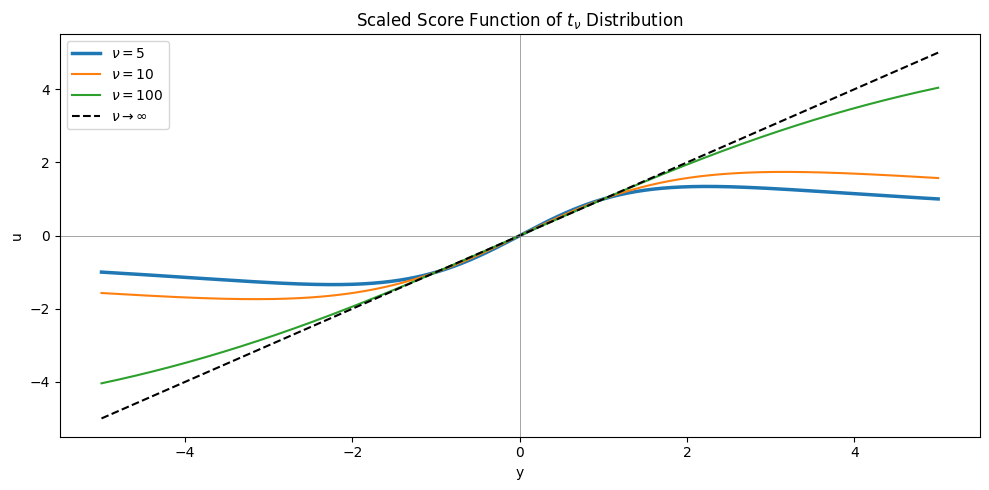

In [77]:
import numpy as np
import matplotlib.pyplot as plt

# Define y values (observations)
y = np.linspace(-5, 5, 5000)

# Scaled score function for Student-t
def scaled_score(y, nu):
    return (nu + 1) * y / (nu + y**2)

# Compute scores
u_nu3 = scaled_score(y, nu=5)
u_nu10 = scaled_score(y, nu=10)
u_nu100 = scaled_score(y, nu=100) # y  # limit as nu → ∞
u_gaussian = y

# Plotting
plt.figure(figsize=(10, 5))
plt.plot(y, u_nu3, label=r'$\nu = 5$', linewidth=2.5)
plt.plot(y, u_nu10, label=r'$\nu = 10$', linewidth=1.5)
plt.plot(y, u_nu100, label=r'$\nu =100$', linewidth=1.5)
plt.plot(y, u_gaussian, '--', label=r'$\nu \rightarrow \infty$', color='black')

plt.axhline(0, color='gray', linewidth=0.5)
plt.axvline(0, color='gray', linewidth=0.5)
plt.xlabel('y')
plt.ylabel('u')
plt.title('Scaled Score Function of $t_ν$ Distribution')
plt.legend()
plt.grid(False)
plt.tight_layout()
plt.show()
